<a href="https://colab.research.google.com/github/Mayara-alvess/04.Projeto-DataLab/blob/main/DataLab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Projeto: Atrasos de Voo - Laboratoria (Débora Vasconcellos e Mayara Alves)

In [1]:

#limpeza e manipucação de dados
import pandas as pd
import numpy as np

#visualização dos dados
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

#machine learning
from sklearn.preprocessing import OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score,balanced_accuracy_score, precision_score, recall_score, f1_score
from sklearn.model_selection import train_test_split,learning_curve, KFold
from sklearn.metrics import confusion_matrix,roc_curve, roc_auc_score, log_loss
from sklearn.ensemble import RandomForestClassifier
from imblearn.over_sampling import SMOTE
from imblearn.over_sampling import ADASYN
from sklearn.datasets import make_regression
from sklearn.linear_model import LinearRegression

import statsmodels.api as sm
import statsmodels.formula.api as smf



In [2]:
df = pd.read_csv("flights_202301.csv")


## Informações Gerais - Tabela flights_202301

In [3]:
#mstrando o dataframe#
df

,FL_DATE,AIRLINE_CODE,DOT_CODE,FL_NUMBER,ORIGIN,ORIGIN_CITY,DEST,DEST_CITY,CRS_DEP_TIME,DEP_TIME,...,AIR_TIME,DISTANCE,DELAY_DUE_CARRIER,DELAY_DUE_WEATHER,DELAY_DUE_NAS,DELAY_DUE_SECURITY,DELAY_DUE_LATE_AIRCRAFT,FL_YEAR,FL_MONTH,FL_DAY
0,2023-01-02,9E,20363,4628,BDL,"Hartford, CT",LGA,"New York, NY",800,757.0,...,25.0,101,NaN,NaN,NaN,NaN,NaN,2023,1,2
1,2023-01-03,9E,20363,4628,BDL,"Hartford, CT",LGA,"New York, NY",800,755.0,...,37.0,101,NaN,NaN,NaN,NaN,NaN,2023,1,3
2,2023-01-04,9E,20363,4628,BDL,"Hartford, CT",LGA,"New York, NY",800,755.0,...,28.0,101,NaN,NaN,NaN,NaN,NaN,2023,1,4
3,2023-01-05,9E,20363,4628,BDL,"Hartford, CT",LGA,"New York, NY",800,754.0,...,38.0,101,NaN,NaN,NaN,NaN,NaN,2023,1,5
4,2023-01-06,9E,20363,4628,BDL,"Hartford, CT",LGA,"New York, NY",800,759.0,...,28.0,101,NaN,NaN,NaN,NaN,NaN,2023,1,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
538832,2023-01-02,UA,19977,1095,EWR,"Newark, NJ",MKE,"Milwaukee, WI",825,836.0,...,110.0,725,NaN,NaN,NaN,NaN,NaN,2023,1,2
538833,2023-01-02,UA,19977,1093,DEN,"Denver, CO",LAX,"Los Angeles, CA",745,752.0,...,111.0,862,7.0,0.0,9.0,0.0,0.0,2023,1,2
538834,2023-01-02,UA,19977,1092,ORD,"Chicago, IL",RSW,"Fort Myers, FL",1400,1504.0,...,150.0,1120,0.0,0.0,54.0,0.0,0.0,2023,1,2
538835,2023-01-02,UA,19977,1092,RSW,"Fort Myers, FL",EWR,"Newark, NJ",1905,NaN,...,NaN,1068,NaN,NaN,NaN,NaN,NaN,2023,1,2


## Verificando o tipo dos dados

In [4]:
#mostrando os tipos de dados das colunas##
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 538837 entries, 0 to 538836
Data columns (total 33 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   FL_DATE                  538837 non-null  object 
 1   AIRLINE_CODE             538837 non-null  object 
 2   DOT_CODE                 538837 non-null  int64  
 3   FL_NUMBER                538837 non-null  int64  
 4   ORIGIN                   538837 non-null  object 
 5   ORIGIN_CITY              538837 non-null  object 
 6   DEST                     538837 non-null  object 
 7   DEST_CITY                538837 non-null  object 
 8   CRS_DEP_TIME             538837 non-null  int64  
 9   DEP_TIME                 528859 non-null  float64
 10  DEP_DELAY                528855 non-null  float64
 11  TAXI_OUT                 528640 non-null  float64
 12  WHEELS_OFF               528640 non-null  float64
 13  WHEELS_ON                528318 non-null  float64
 14  TAXI

## Principais estatísticas

In [5]:
##mostrando as principais estatísticas das colunas##
df.describe()

,DOT_CODE,FL_NUMBER,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,...,AIR_TIME,DISTANCE,DELAY_DUE_CARRIER,DELAY_DUE_WEATHER,DELAY_DUE_NAS,DELAY_DUE_SECURITY,DELAY_DUE_LATE_AIRCRAFT,FL_YEAR,FL_MONTH,FL_DAY
count,538837.000000,538837.000000,538837.000000,528859.000000,528855.000000,528640.000000,528640.000000,528318.000000,528318.000000,538837.000000,...,527197.000000,538837.000000,116713.000000,116713.000000,116713.000000,116713.000000,116713.000000,538837.0,538837.0,538837.000000
mean,19944.883041,2201.929604,1327.415619,1334.441891,12.937247,18.334566,1358.483518,1471.856121,8.038000,1497.177636,...,115.814365,830.110802,24.509343,4.383968,14.648488,0.146248,25.755743,2023.0,1.0,16.095398
std,374.068602,1547.198171,489.902674,502.427715,55.435948,10.624460,503.858558,532.185174,6.416574,515.236763,...,71.811305,600.126873,73.732581,38.069314,32.531918,2.895832,57.507827,0.0,0.0,8.929168
min,19393.000000,1.000000,5.000000,1.000000,-52.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,8.000000,31.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2023.0,1.0,1.000000
25%,19790.000000,972.000000,910.000000,917.000000,-6.000000,12.000000,934.000000,1054.000000,4.000000,1109.000000,...,63.000000,397.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2023.0,1.0,8.000000
50%,19930.000000,1909.000000,1320.000000,1327.000000,-2.000000,15.000000,1341.000000,1509.000000,6.000000,1520.000000,...,99.000000,679.000000,3.000000,0.000000,1.000000,0.000000,0.000000,2023.0,1.0,16.000000
75%,20363.000000,3056.000000,1732.000000,1743.000000,10.000000,21.000000,1757.000000,1917.000000,9.000000,1927.000000,...,146.000000,1067.000000,23.000000,0.000000,18.000000,0.000000,29.000000,2023.0,1.0,24.000000
max,20452.000000,9887.000000,2359.000000,2400.000000,3024.000000,222.000000,2400.000000,2400.000000,173.000000,2359.000000,...,695.000000,5095.000000,3024.000000,1653.000000,1343.000000,234.000000,2027.000000,2023.0,1.0,31.000000


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 538837 entries, 0 to 538836
Data columns (total 33 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   FL_DATE                  538837 non-null  object 
 1   AIRLINE_CODE             538837 non-null  object 
 2   DOT_CODE                 538837 non-null  int64  
 3   FL_NUMBER                538837 non-null  int64  
 4   ORIGIN                   538837 non-null  object 
 5   ORIGIN_CITY              538837 non-null  object 
 6   DEST                     538837 non-null  object 
 7   DEST_CITY                538837 non-null  object 
 8   CRS_DEP_TIME             538837 non-null  int64  
 9   DEP_TIME                 528859 non-null  float64
 10  DEP_DELAY                528855 non-null  float64
 11  TAXI_OUT                 528640 non-null  float64
 12  WHEELS_OFF               528640 non-null  float64
 13  WHEELS_ON                528318 non-null  float64
 14  TAXI

## Verificando se encontramos valores nulos

In [7]:
##somando os valores nulos##
df.isnull().sum()

FL_DATE                         0
AIRLINE_CODE                    0
DOT_CODE                        0
FL_NUMBER                       0
ORIGIN                          0
ORIGIN_CITY                     0
DEST                            0
DEST_CITY                       0
CRS_DEP_TIME                    0
DEP_TIME                     9978
DEP_DELAY                    9982
TAXI_OUT                    10197
WHEELS_OFF                  10197
WHEELS_ON                   10519
TAXI_IN                     10519
CRS_ARR_TIME                    0
ARR_TIME                    10519
ARR_DELAY                   11640
CANCELLED                       0
CANCELLATION_CODE               0
DIVERTED                        0
CRS_ELAPSED_TIME                1
ELAPSED_TIME                11640
AIR_TIME                    11640
DISTANCE                        0
DELAY_DUE_CARRIER          422124
DELAY_DUE_WEATHER          422124
DELAY_DUE_NAS              422124
DELAY_DUE_SECURITY         422124
DELAY_DUE_LATE

## Selecionando colunas com nulos que iremos remover

In [8]:
#selecionando colunas que iremos remover os nulos#
colunas_nulos_remover = ["DEP_TIME", "DEP_DELAY", "TAXI_OUT", "WHEELS_OFF","TAXI_IN", "ARR_TIME", "ARR_DELAY","CRS_ELAPSED_TIME","ELAPSED_TIME","AIR_TIME"]
df.dropna(subset=colunas_nulos_remover, inplace=True)

## Verificando se os nulos foram removidos

In [9]:
##verificando se os nulos das variaveis selecionadas saíram##
df.isnull().sum()

FL_DATE                         0
AIRLINE_CODE                    0
DOT_CODE                        0
FL_NUMBER                       0
ORIGIN                          0
ORIGIN_CITY                     0
DEST                            0
DEST_CITY                       0
CRS_DEP_TIME                    0
DEP_TIME                        0
DEP_DELAY                       0
TAXI_OUT                        0
WHEELS_OFF                      0
WHEELS_ON                       0
TAXI_IN                         0
CRS_ARR_TIME                    0
ARR_TIME                        0
ARR_DELAY                       0
CANCELLED                       0
CANCELLATION_CODE               0
DIVERTED                        0
CRS_ELAPSED_TIME                0
ELAPSED_TIME                    0
AIR_TIME                        0
DISTANCE                        0
DELAY_DUE_CARRIER          410484
DELAY_DUE_WEATHER          410484
DELAY_DUE_NAS              410484
DELAY_DUE_SECURITY         410484
DELAY_DUE_LATE

## Alterado os valores nulos restantes para 0

In [10]:
##alterando os para nulos para 0##
df.fillna(0,inplace=True)

## Confirmando se os nossos dados estão sem os nulos

In [11]:
#efetuando a soma novamente, para verificar se os nulos saíram#
df.isnull().sum()

FL_DATE                    0
AIRLINE_CODE               0
DOT_CODE                   0
FL_NUMBER                  0
ORIGIN                     0
ORIGIN_CITY                0
DEST                       0
DEST_CITY                  0
CRS_DEP_TIME               0
DEP_TIME                   0
DEP_DELAY                  0
TAXI_OUT                   0
WHEELS_OFF                 0
WHEELS_ON                  0
TAXI_IN                    0
CRS_ARR_TIME               0
ARR_TIME                   0
ARR_DELAY                  0
CANCELLED                  0
CANCELLATION_CODE          0
DIVERTED                   0
CRS_ELAPSED_TIME           0
ELAPSED_TIME               0
AIR_TIME                   0
DISTANCE                   0
DELAY_DUE_CARRIER          0
DELAY_DUE_WEATHER          0
DELAY_DUE_NAS              0
DELAY_DUE_SECURITY         0
DELAY_DUE_LATE_AIRCRAFT    0
FL_YEAR                    0
FL_MONTH                   0
FL_DAY                     0
dtype: int64

## Verificando se encontramos valores duplicados

In [12]:
##verificando se há duplicados##
df.duplicated().sum()

0

## Consulta para verificar a presença de dados discrepantes nas variáveis categóricas




In [13]:

num_nomes_unicos = df['ORIGIN_CITY'].nunique()
nomes_unicos = df['ORIGIN_CITY'].unique()

# Imprimir o número de nomes únicos
print(f"Número de nomes únicos em ORIGIN_CITY: {num_nomes_unicos}")

# Imprimir os nomes únicos
print("Nomes únicos em ORIGIN_CITY:")
print(nomes_unicos)

Número de nomes únicos em ORIGIN_CITY: 333
Nomes únicos em ORIGIN_CITY:
['Hartford, CT' 'New York, NY' 'Duluth, MN' 'Atlanta, GA'
 'Fayetteville, NC' 'Norfolk, VA' 'Minneapolis, MN' 'Pittsburgh, PA'
 'Baltimore, MD' 'Roanoke, VA' 'Detroit, MI' 'Knoxville, TN'
 'Cincinnati, OH' 'Wilmington, NC' 'Cedar Rapids/Iowa City, IA'
 'Charleston/Dunbar, WV' 'Bangor, ME' 'Raleigh/Durham, NC' 'Dayton, OH'
 'Key West, FL' 'Newark, NJ' 'Charlotte, NC' 'St. Louis, MO'
 'Evansville, IN' 'Greer, SC' 'Fayetteville, AR' 'Jacksonville, FL'
 'Providence, RI' 'Charleston, SC' 'Savannah, GA' 'Grand Rapids, MI'
 'Cleveland, OH' 'Chattanooga, TN' 'Lafayette, LA' 'Asheville, NC'
 'Green Bay, WI' 'Milwaukee, WI' 'Gainesville, FL' 'Chicago, IL'
 'Burlington, VT' 'Richmond, VA' 'Saginaw/Bay City/Midland, MI'
 'Albany, NY' 'Baton Rouge, LA' 'Montgomery, AL' 'Minot, ND'
 'Greensboro/High Point, NC' 'Nashville, TN' 'State College, PA'
 'Philadelphia, PA' 'Memphis, TN' 'Omaha, NE' 'Madison, WI'
 'Marquette, MI' 'Applet

In [ ]:
num_nomes_unicos = df['DEST_CITY'].nunique()
nomes_unicos = df['DEST_CITY'].unique()

# Imprimir o número de nomes únicos
print(f"Número de nomes únicos em DEST_CITY: {num_nomes_unicos}")

# Imprimir os nomes únicos
print("Nomes únicos em DEST_CITY:")
print(nomes_unicos)

Número de nomes únicos em DEST_CITY: 333
Nomes únicos em DEST_CITY:
['New York, NY' 'Cincinnati, OH' 'Binghamton, NY' 'Minneapolis, MN'
 'Fayetteville, NC' 'Atlanta, GA' 'Ithaca/Cortland, NY' 'Detroit, MI'
 'Pittsburgh, PA' 'Baltimore, MD' 'Cedar Rapids/Iowa City, IA'
 'Louisville, KY' 'Greer, SC' 'Wilmington, NC' 'Newark, NJ'
 'Charleston/Dunbar, WV' 'Charlottesville, VA' 'Dayton, OH' 'Savannah, GA'
 'Charlotte, NC' 'Raleigh/Durham, NC' 'St. Louis, MO' 'Knoxville, TN'
 'Jacksonville, FL' 'Washington, DC' 'Traverse City, MI' 'Cleveland, OH'
 'Charleston, SC' 'Grand Rapids, MI' 'Providence, RI' 'Des Moines, IA'
 'Chattanooga, TN' 'Austin, TX' 'Lafayette, LA' 'Asheville, NC'
 'Green Bay, WI' 'Norfolk, VA' 'Milwaukee, WI' 'Gainesville, FL'
 'Chicago, IL' 'Burlington, VT' 'Saginaw/Bay City/Midland, MI'
 'Baton Rouge, LA' 'Evansville, IN' 'Albany, NY' 'Montgomery, AL'
 'Minot, ND' 'Fayetteville, AR' 'Valdosta, GA' 'Buffalo, NY' 'Roanoke, VA'
 'Kansas City, MO' 'Nashville, TN' 'Philadelphia,

## Histrograma para visualização das varíaveis numéricas

In [ ]:
#Visualizando Histogramas
import plotly.express as px

def plot_histogram(dataframe, column, title):
    fig = px.histogram(dataframe, x=column, title=title)
    fig.show()

# Lista de colunas e títulos correspondentes
columns_titles = [
    ("DEP_DELAY", "Distribuição de voos pela diferença em minutos entre o horário de partida programado e o real"),
    ("ARR_DELAY", "Distribuição de voos pela diferença em minutos entre o horário de chegada e o real"),
    ("CRS_ELAPSED_TIME", "Distribuição do tempo total de voo decorrido em minutos registrado no CRS"),
    ("DELAY_DUE_WEATHER", "Distribuição de atraso climático em minutos"),
    ("DELAY_DUE_CARRIER", "Distribuição de voos por atraso da operadora em minutos"),
    ("DELAY_DUE_NAS", "Distribuição do atraso do Sistema Aéreo Nacional em Minutos"),
    ("DELAY_DUE_SECURITY", "Distribuição de atraso de segurança em minutos"),
    ("DELAY_DUE_LATE_AIRCRAFT", "Distribuição de atraso de aeronaves atrasadas em minutos")
]

# Gerar os histogramas
for column, title in columns_titles:
    plot_histogram(df, column, title)


## Criando variável categórica para horário de voo

In [14]:
# Função para categorizar os horários
def categorizar_horario(horario):

    if 0 <= horario < 600:
        return 'Late Night'
    elif 600 <= horario < 1200:
        return 'Morning'
    elif 1200 <= horario < 1800:
        return 'Afternoon'
    elif 1800 <= horario <= 2400:
        return 'Evening'
    else:
        return 'Invalid Hour'  # Para garantir que todos os horários sejam cobertos

# Aplicar a função para categorizar os horários de partida e chegada previstos
df['CAT_CRS_DEP_TIME'] = df['CRS_DEP_TIME'].apply(categorizar_horario)
df['CAT_CRS_ARR_TIME'] = df['CRS_ARR_TIME'].apply(categorizar_horario)

# Verificar as mudanças
print(df[['CRS_DEP_TIME', 'CAT_CRS_DEP_TIME', 'CRS_ARR_TIME', 'CAT_CRS_ARR_TIME']].head())







   CRS_DEP_TIME CAT_CRS_DEP_TIME  CRS_ARR_TIME CAT_CRS_ARR_TIME
0           800          Morning           905          Morning
1           800          Morning           905          Morning
2           800          Morning           905          Morning
3           800          Morning           905          Morning
4           800          Morning           905          Morning


## Formatando as colunas selecionadas para o formato de hora

In [15]:
# Listar as colunas que precisam ser formatadas
colunas_de_tempo = [
    'CRS_DEP_TIME',
    'DEP_TIME',
    'WHEELS_OFF',
    'WHEELS_ON',
    'CRS_ARR_TIME',
    'ARR_TIME'
]

# Função para formatar o tempo de hhmm para hh:mm
def formatar_tempo(valor):
    if pd.isna(valor) or valor == '':
        return valor  # Retorna o valor original
    valor_str = str(int(valor)).zfill(4)  # Converte para string
    if valor_str == '2400':
        return '00:00'  # Caso especial: transforma "2400" em "00:00"
    return f"{valor_str[:2]}:{valor_str[2:]}"  # Formata como hh:mm

# Aplicando a formatação para cada coluna de tempo
for coluna in colunas_de_tempo:
    df[coluna] = df[coluna].apply(formatar_tempo)

# Verificando as mudanças
print(df[colunas_de_tempo].head())


  CRS_DEP_TIME DEP_TIME WHEELS_OFF WHEELS_ON CRS_ARR_TIME ARR_TIME
0        08:00    07:57      08:08     08:33        09:05    08:53
1        08:00    07:55      08:14     08:51        09:05    08:57
2        08:00    07:55      08:09     08:37        09:05    08:44
3        08:00    07:54      08:07     08:45        09:05    08:48
4        08:00    07:59      08:16     08:44        09:05    08:49


## Formatando as colunas para INT64

In [16]:
# Listar as colunas que precisam ser formatadas para int64
colunas_para_int = [
    'DEP_DELAY',
    'ARR_DELAY',
    'CRS_ELAPSED_TIME',
    'ELAPSED_TIME',
    'AIR_TIME',
    'DELAY_DUE_CARRIER',
    'DELAY_DUE_WEATHER',
    'DELAY_DUE_NAS',
    'DELAY_DUE_SECURITY',
    'DELAY_DUE_LATE_AIRCRAFT'
]

# Converter as colunas para int64
for coluna in colunas_para_int:
    df[coluna] = df[coluna].astype('Int64')

# Verificar as mudanças
print(df[colunas_para_int].dtypes)
print(df[colunas_para_int].head())

DEP_DELAY                  Int64
ARR_DELAY                  Int64
CRS_ELAPSED_TIME           Int64
ELAPSED_TIME               Int64
AIR_TIME                   Int64
DELAY_DUE_CARRIER          Int64
DELAY_DUE_WEATHER          Int64
DELAY_DUE_NAS              Int64
DELAY_DUE_SECURITY         Int64
DELAY_DUE_LATE_AIRCRAFT    Int64
dtype: object
   DEP_DELAY  ARR_DELAY  CRS_ELAPSED_TIME  ELAPSED_TIME  AIR_TIME  \
0         -3        -12                65            56        25   
1         -5         -8                65            62        37   
2         -5        -21                65            49        28   
3         -6        -17                65            54        38   
4         -1        -16                65            50        28   

   DELAY_DUE_CARRIER  DELAY_DUE_WEATHER  DELAY_DUE_NAS  DELAY_DUE_SECURITY  \
0                  0                  0              0                   0   
1                  0                  0              0                   0   
2      

## Correlação das varíaveis

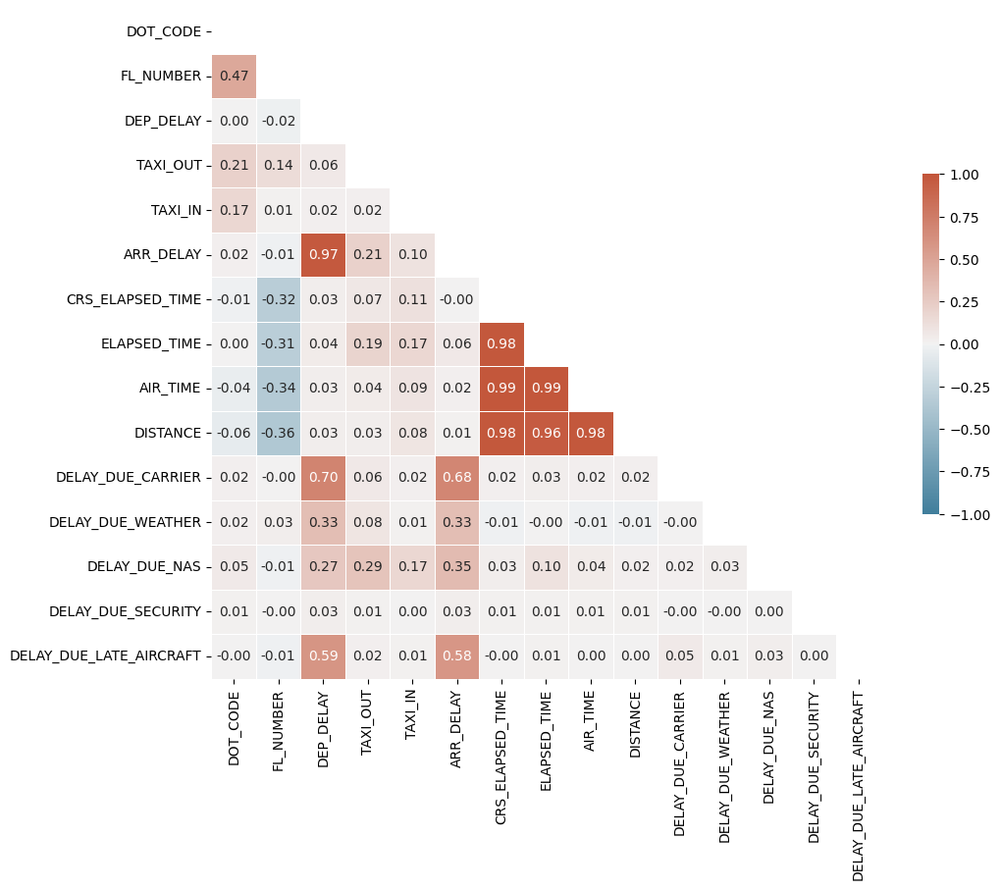

In [17]:

# Selecionar apenas colunas numéricas para cálculo de correlação
numeric_df = df.select_dtypes(include=[np.number])

# Gerar a matriz de correlação
corr = numeric_df.corr().round(2)

# Remover colunas específicas da matriz de correlação
colunas_para_remover = ['CANCELLED', 'FL_YEAR', 'FL_MONTH', 'FL_DAY','DIVERTED']
corr = corr.drop(columns=colunas_para_remover, index=colunas_para_remover)

# Código para remover o triângulo superior
mask = np.triu(np.ones_like(corr, dtype=bool))

# Configure a figura do matplotlib
f, ax = plt.subplots(figsize=(11, 9))

# Gere um mapa de cores divergente personalizado
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Desenhe o mapa de calor com a máscara e a proporção correta e anote os valores
sns.heatmap(corr, mask=mask, cmap=cmap, vmin=-1, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt=".2f")

plt.show()



## Criando nova variável dia da semana

In [18]:
# Converter a coluna FL_DATE para o formato de data
df['FL_DATE'] = pd.to_datetime(df['FL_DATE'])

# Criar a nova coluna com o dia da semana
df['DAY_OF_WEEK'] = df['FL_DATE'].dt.day_name()

#Verificar mudanças
print(df)

          FL_DATE AIRLINE_CODE  DOT_CODE  FL_NUMBER ORIGIN  \
0      2023-01-02           9E     20363       4628    BDL   
1      2023-01-03           9E     20363       4628    BDL   
2      2023-01-04           9E     20363       4628    BDL   
3      2023-01-05           9E     20363       4628    BDL   
4      2023-01-06           9E     20363       4628    BDL   
...           ...          ...       ...        ...    ...   
538831 2023-01-02           UA     19977       1097    FLL   
538832 2023-01-02           UA     19977       1095    EWR   
538833 2023-01-02           UA     19977       1093    DEN   
538834 2023-01-02           UA     19977       1092    ORD   
538836 2023-01-02           UA     19977       1086    IAH   

                ORIGIN_CITY DEST          DEST_CITY CRS_DEP_TIME DEP_TIME  \
0              Hartford, CT  LGA       New York, NY        08:00    07:57   
1              Hartford, CT  LGA       New York, NY        08:00    07:55   
2              Hartford,

## Unificando as tabelas

In [19]:
# Leitura dos dicionários de códigos
airline_code_dict = pd.read_csv("AIRLINE_CODE_DICTIONARY.csv")
dot_code_dict = pd.read_csv("DOT_CODE_DICTIONARY.csv")

# Renomear as colunas 'code' nos dicionários
airline_code_dict = airline_code_dict.rename(columns={'Code': 'AIRLINE_CODE', 'Description': 'AIRLINE_NAME'})
dot_code_dict = dot_code_dict.rename(columns={'Code': 'DOT_CODE', 'Description': 'DOT_NAME'})
# Verificar as primeiras linhas para entender a estrutura
print(airline_code_dict.head())
print(dot_code_dict.head())
# Realizar a mesclagem (merge) com base nas colunas correspondentes
# Mesclar com o dicionário de AIRLINE_CODE
df = df.merge(airline_code_dict, how='left', on='AIRLINE_CODE')
# Mesclar com o dicionário de DOT_CODE
df = df.merge(dot_code_dict, how='left', on='DOT_CODE')
# Função para determinar a principal causa de atraso com base nos somatórios
def principal_causa_atraso(row):
    causas = {
        'Carrier': row['DELAY_DUE_CARRIER'],
        'Weather': row['DELAY_DUE_WEATHER'],
        'National Airspace System': row['DELAY_DUE_NAS'],
        'Security': row['DELAY_DUE_SECURITY'],
        'Due delay': row['DELAY_DUE_LATE_AIRCRAFT']
    }
    if all(value == 0 for value in causas.values()):
        return 'Without delay'
    principal_causa = max(causas, key=causas.get)
    return principal_causa
# Aplicar a função para criar a nova coluna
df['MAIN_CAUSE_DELAY'] = df.apply(principal_causa_atraso, axis=1)
# Criar uma nova coluna binária indicando se o voo teve algum atraso
df['DELAY_FLAG'] = df.apply(lambda row: 0 if row['MAIN_CAUSE_DELAY'] == 'Without delay' else 1, axis=1)
# Criar a nova coluna 'FLIGHT_ROUTE'
df['FLIGHT_ROUTE'] = df['ORIGIN_CITY'] + ' - ' + df['DEST_CITY']
# Selecionar as colunas desejadas
# Incluindo as colunas originais e adicionando as colunas com os nomes dos códigos
colunas_selecionadas = ['FL_DATE', 'AIRLINE_CODE', 'AIRLINE_NAME', 'DOT_CODE', 'DOT_NAME', 'FL_NUMBER', 'ORIGIN', 'ORIGIN_CITY', 'DEST', 'DEST_CITY',
                        'CRS_DEP_TIME', 'DEP_TIME', 'DEP_DELAY', 'CRS_ARR_TIME', 'ARR_TIME',  'ARR_DELAY',
                        'CRS_ELAPSED_TIME', 'ELAPSED_TIME', 'AIR_TIME', 'DISTANCE', 'DELAY_DUE_CARRIER', 'DELAY_DUE_WEATHER', 'DELAY_DUE_NAS',
                        'DELAY_DUE_SECURITY', 'DELAY_DUE_LATE_AIRCRAFT', 'FL_YEAR', 'FL_MONTH', 'FL_DAY', 'MAIN_CAUSE_DELAY', 'DELAY_FLAG', 'FLIGHT_ROUTE','CAT_CRS_DEP_TIME','CAT_CRS_ARR_TIME','DAY_OF_WEEK']
# Ajustar a lista acima conforme necessário
df = df[colunas_selecionadas]
# Verificar as mudanças
print(df.head())

  AIRLINE_CODE                   AIRLINE_NAME
0          02Q                  Titan Airways
1          04Q             Tradewind Aviation
2          05Q            Comlux Aviation, AG
3          06Q  Master Top Linhas Aereas Ltd.
4          07Q            Flair Airlines Ltd.
   DOT_CODE                         DOT_NAME
0     19031   Mackey International Inc.: MAC
1     19032  Munz Northern Airlines Inc.: XY
2     19033       Cochise Airlines Inc.: COC
3     19034   Golden Gate Airlines Inc.: GSA
4     19035               Aeromech Inc.: RZZ
     FL_DATE AIRLINE_CODE       AIRLINE_NAME  DOT_CODE               DOT_NAME  \
0 2023-01-02           9E  Endeavor Air Inc.     20363  Endeavor Air Inc.: 9E   
1 2023-01-03           9E  Endeavor Air Inc.     20363  Endeavor Air Inc.: 9E   
2 2023-01-04           9E  Endeavor Air Inc.     20363  Endeavor Air Inc.: 9E   
3 2023-01-05           9E  Endeavor Air Inc.     20363  Endeavor Air Inc.: 9E   
4 2023-01-06           9E  Endeavor Air Inc.     

## Verificando a unificação

In [20]:
df

,FL_DATE,AIRLINE_CODE,AIRLINE_NAME,DOT_CODE,DOT_NAME,FL_NUMBER,ORIGIN,ORIGIN_CITY,DEST,DEST_CITY,...,DELAY_DUE_LATE_AIRCRAFT,FL_YEAR,FL_MONTH,FL_DAY,MAIN_CAUSE_DELAY,DELAY_FLAG,FLIGHT_ROUTE,CAT_CRS_DEP_TIME,CAT_CRS_ARR_TIME,DAY_OF_WEEK
0,2023-01-02,9E,Endeavor Air Inc.,20363,Endeavor Air Inc.: 9E,4628,BDL,"Hartford, CT",LGA,"New York, NY",...,0,2023,1,2,Without delay,0,"Hartford, CT - New York, NY",Morning,Morning,Monday
1,2023-01-03,9E,Endeavor Air Inc.,20363,Endeavor Air Inc.: 9E,4628,BDL,"Hartford, CT",LGA,"New York, NY",...,0,2023,1,3,Without delay,0,"Hartford, CT - New York, NY",Morning,Morning,Tuesday
2,2023-01-04,9E,Endeavor Air Inc.,20363,Endeavor Air Inc.: 9E,4628,BDL,"Hartford, CT",LGA,"New York, NY",...,0,2023,1,4,Without delay,0,"Hartford, CT - New York, NY",Morning,Morning,Wednesday
3,2023-01-05,9E,Endeavor Air Inc.,20363,Endeavor Air Inc.: 9E,4628,BDL,"Hartford, CT",LGA,"New York, NY",...,0,2023,1,5,Without delay,0,"Hartford, CT - New York, NY",Morning,Morning,Thursday
4,2023-01-06,9E,Endeavor Air Inc.,20363,Endeavor Air Inc.: 9E,4628,BDL,"Hartford, CT",LGA,"New York, NY",...,0,2023,1,6,Without delay,0,"Hartford, CT - New York, NY",Morning,Morning,Friday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
527192,2023-01-02,UA,United Air Lines Inc.,19977,United Air Lines Inc.: UA,1097,FLL,"Fort Lauderdale, FL",ORD,"Chicago, IL",...,0,2023,1,2,Without delay,0,"Fort Lauderdale, FL - Chicago, IL",Morning,Morning,Monday
527193,2023-01-02,UA,United Air Lines Inc.,19977,United Air Lines Inc.: UA,1095,EWR,"Newark, NJ",MKE,"Milwaukee, WI",...,0,2023,1,2,Without delay,0,"Newark, NJ - Milwaukee, WI",Morning,Morning,Monday
527194,2023-01-02,UA,United Air Lines Inc.,19977,United Air Lines Inc.: UA,1093,DEN,"Denver, CO",LAX,"Los Angeles, CA",...,0,2023,1,2,National Airspace System,1,"Denver, CO - Los Angeles, CA",Morning,Morning,Monday
527195,2023-01-02,UA,United Air Lines Inc.,19977,United Air Lines Inc.: UA,1092,ORD,"Chicago, IL",RSW,"Fort Myers, FL",...,0,2023,1,2,National Airspace System,1,"Chicago, IL - Fort Myers, FL",Afternoon,Evening,Monday


##Criando a variável HAS_DELAY para atrasos

In [21]:
df['HAS_DELAY'] = np.where(df['DEP_DELAY'] >= 10, 1, 0)

## Calculando a média de atraso por dia da semana na partida

In [22]:
# Agrupe pelos dias da semana e calcule a média dos atrasos de partida
avg_delay_by_day = df.groupby('DAY_OF_WEEK')['DEP_DELAY'].mean().sort_values(ascending=False)

# Exiba os dias da semana com os maiores atrasos médios
print(avg_delay_by_day)

DAY_OF_WEEK
Wednesday    26.512092
Monday       14.835887
Tuesday      11.945814
Sunday        11.84121
Thursday     10.796048
Friday        7.646719
Saturday      6.362471
Name: DEP_DELAY, dtype: Float64


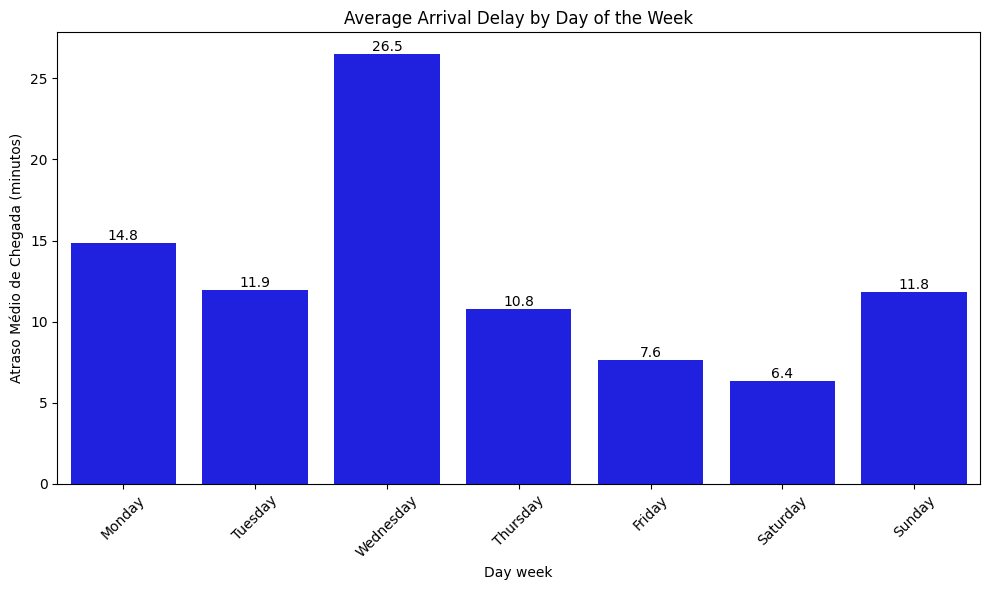

In [23]:
# Calculando a média de atraso de partida por dia da semana
avg_delay_by_day = df.groupby('DAY_OF_WEEK')['DEP_DELAY'].mean().sort_values(ascending=False)

# Importando as bibliotecas necessárias
import matplotlib.pyplot as plt
import seaborn as sns

# Definindo a ordem dos dias da semana para plotagem ordenada
order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Criando o gráfico de barras
plt.figure(figsize=(10, 6))
ax = sns.barplot(x=avg_delay_by_day.index, y=avg_delay_by_day.values, order=order, color='blue')
plt.title('Average Arrival Delay by Day of the Week')
plt.xlabel('Day week')
plt.ylabel('Atraso Médio de Chegada (minutos)')
plt.xticks(rotation=45)

# Adicionando legendas em cima das barras
for p in ax.patches:
    ax.annotate(f'{p.get_height():.1f}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.tight_layout()
plt.show()


## Calculando a média de atraso por dia da semana na chegada

In [24]:

# Agrupe pelos dias da semana e calcule a média dos atrasos de chegada
avg_delay_by_day = df.groupby('DAY_OF_WEEK')['ARR_DELAY'].mean().sort_values(ascending=False)

# Exiba os dias da semana com os maiores atrasos médios
print(avg_delay_by_day)


DAY_OF_WEEK
Wednesday    22.381358
Monday       10.046084
Thursday      6.828551
Sunday        6.679393
Tuesday       6.500326
Friday         2.26365
Saturday     -0.370059
Name: ARR_DELAY, dtype: Float64


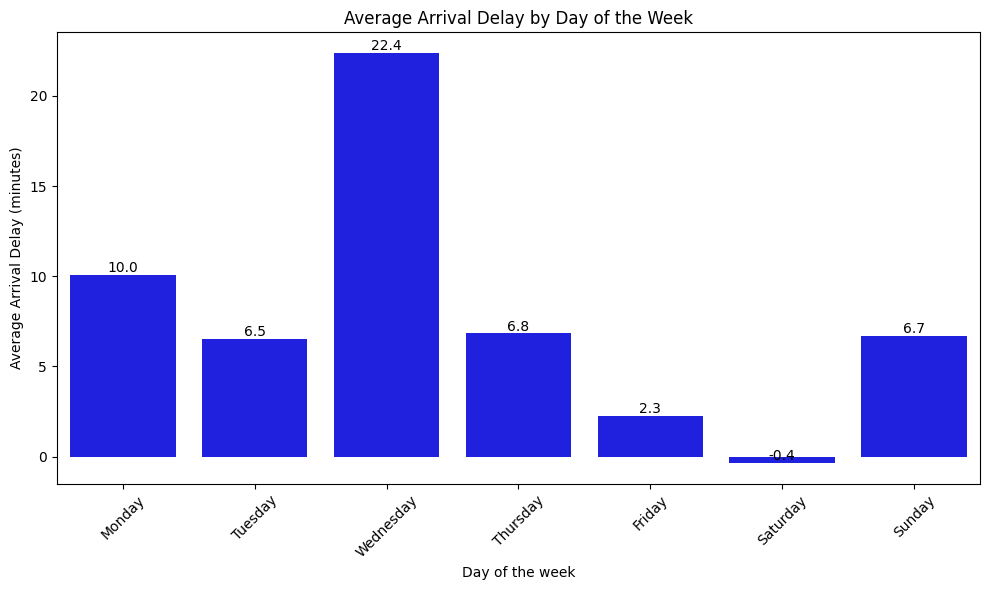

In [ ]:
# Calculando a média de atraso de chegada por dia da semana
avg_delay_by_day = df.groupby('DAY_OF_WEEK')['ARR_DELAY'].mean().sort_values(ascending=False)

# Importando as bibliotecas necessárias
import matplotlib.pyplot as plt
import seaborn as sns

# Definindo a ordem dos dias da semana para plotagem ordenada
order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Criando o gráfico de barras
plt.figure(figsize=(10, 6))
ax = sns.barplot(x=avg_delay_by_day.index, y=avg_delay_by_day.values, order=order, color='blue')
plt.title('Average Arrival Delay by Day of the Week')
plt.xlabel('Day of the week')
plt.ylabel('Average Arrival Delay (minutes)')
plt.xticks(rotation=45)

# Adicionando legendas em cima das barras
for p in ax.patches:
    ax.annotate(f'{p.get_height():.1f}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.tight_layout()
plt.show()


## Porcentagem e média de atrasos na partida

In [25]:

flight_counts = df['CAT_CRS_DEP_TIME'].value_counts()
average_delays = df.groupby('CAT_CRS_DEP_TIME')['DEP_DELAY'].mean()

print("Contagem de voos por segmento:")
print(flight_counts)

print("\nMédia de atrasos por segmento:")
print(average_delays)


Contagem de voos por segmento:
CAT_CRS_DEP_TIME
Morning       205409
Afternoon     188313
Evening       118329
Late Night     15146
Name: count, dtype: int64

Média de atrasos por segmento:
CAT_CRS_DEP_TIME
Afternoon     14.279423
Evening       17.169181
Late Night     9.430939
Morning        9.280309
Name: DEP_DELAY, dtype: Float64


## Porcentagem e média de atrasos na chegada

In [26]:
flight_counts = df['CAT_CRS_ARR_TIME'].value_counts()
flight_percentages = (flight_counts / flight_counts.sum()) * 100
average_delays = df.groupby('CAT_CRS_ARR_TIME')['DEP_DELAY'].mean()

print("Porcentagem de voos por segmento:")
print(flight_percentages)

print("\nMédia de atrasos por segmento:")
print(average_delays)


Porcentagem de voos por segmento:
CAT_CRS_ARR_TIME
Afternoon     36.297817
Evening       33.702771
Morning       27.737829
Late Night     2.261583
Name: count, dtype: float64

Média de atrasos por segmento:
CAT_CRS_ARR_TIME
Afternoon     12.135743
Evening       16.796088
Late Night    20.465655
Morning        8.336449
Name: DEP_DELAY, dtype: Float64


##Boxplot para visualição dos dados

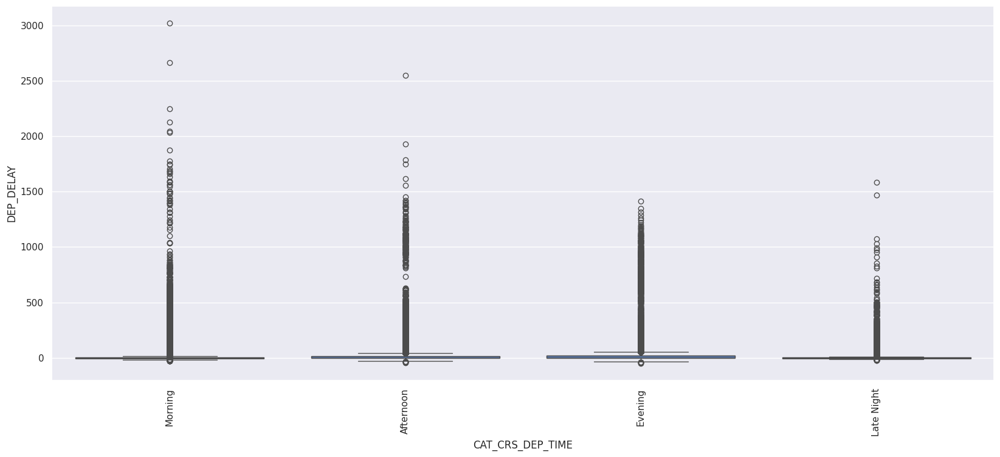

In [ ]:
sns.set(rc = {'figure.figsize':(20,8)})
fig = sns.boxplot(x="CAT_CRS_DEP_TIME", y='DEP_DELAY',data=df)
plt.xticks(rotation=90);

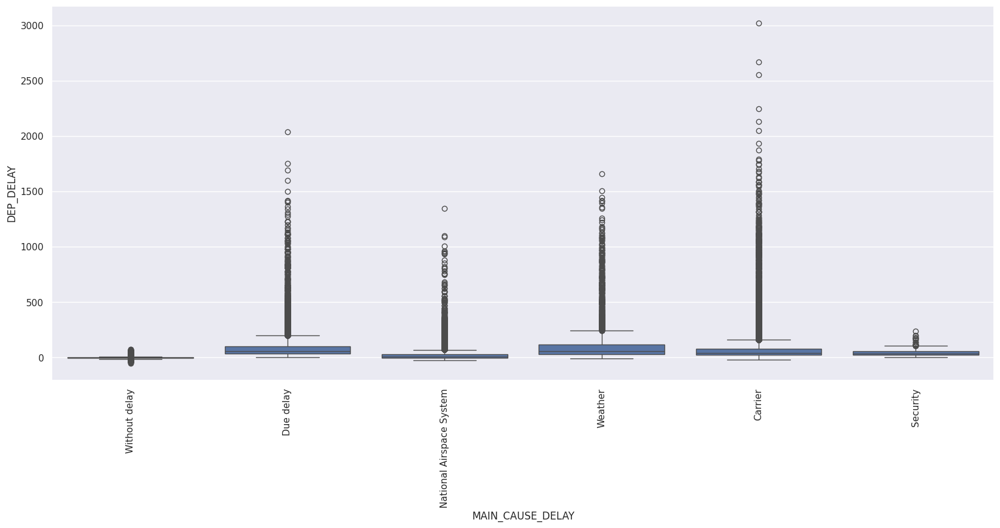

In [ ]:
sns.set(rc = {'figure.figsize':(20,8)})
fig = sns.boxplot(x="MAIN_CAUSE_DELAY", y='DEP_DELAY',data=df)
plt.xticks(rotation=90);

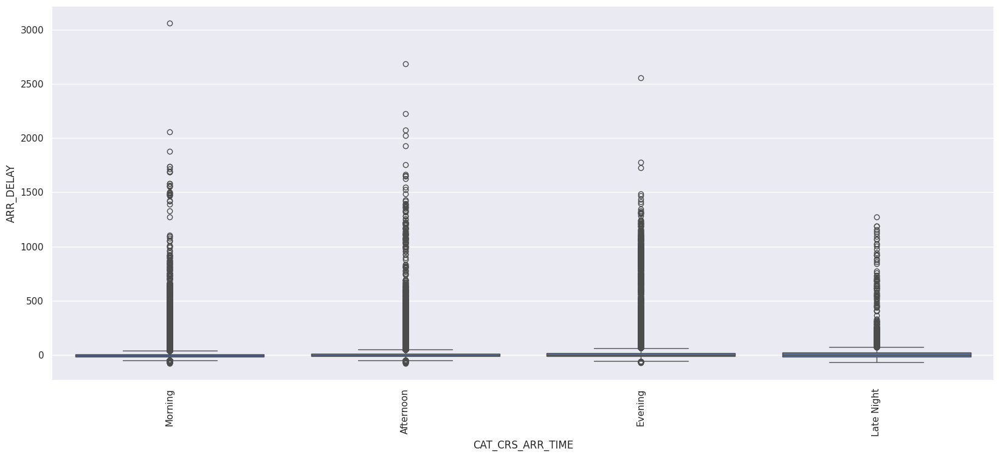

In [ ]:
sns.set(rc = {'figure.figsize':(20,8)})
fig = sns.boxplot(x="CAT_CRS_ARR_TIME", y='ARR_DELAY',data=df)
plt.xticks(rotation=90);

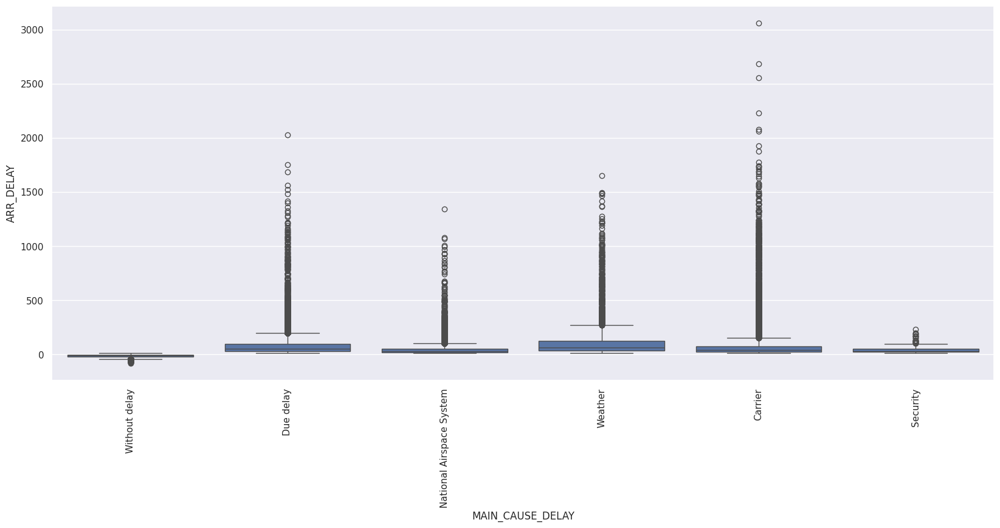

In [ ]:
sns.set(rc = {'figure.figsize':(20,8)})
fig = sns.boxplot(x="MAIN_CAUSE_DELAY", y='ARR_DELAY',data=df)
plt.xticks(rotation=90);

In [ ]:
# Filtrar valores acima de 2400 na coluna DEP_DELAY
result = df[df['DEP_DELAY'] > 2400]

# Ajustar opções de exibição para mostrar todas as colunas
pd.set_option('display.max_columns', None)  # Mostrar todas as colunas
pd.set_option('display.expand_frame_repr', False)  # Não quebrar linhas

# Exibir todas as colunas do resultado
print(result)

          FL_DATE AIRLINE_CODE  DOT_CODE  FL_NUMBER ORIGIN         ORIGIN_CITY DEST      DEST_CITY  CRS_DEP_TIME  DEP_TIME  DEP_DELAY  TAXI_OUT  WHEELS_OFF  WHEELS_ON  TAXI_IN  CRS_ARR_TIME  ARR_TIME  ARR_DELAY  CANCELLED CANCELLATION_CODE  DIVERTED  CRS_ELAPSED_TIME  ELAPSED_TIME  AIR_TIME  DISTANCE  DELAY_DUE_CARRIER  DELAY_DUE_WEATHER  DELAY_DUE_NAS  DELAY_DUE_SECURITY  DELAY_DUE_LATE_AIRCRAFT  FL_YEAR  FL_MONTH  FL_DAY
20076  2023-01-03           AA     19805        369    SNA       Santa Ana, CA  JFK   New York, NY          1400     834.0     2554.0      11.0       845.0     1620.0     16.0          2159    1636.0     2557.0          0                 Z         0             299.0         302.0     275.0      2454             2554.0                0.0            3.0                 0.0                      0.0     2023         1       3
54466  2023-01-24           AA     19805       1975    SLC  Salt Lake City, UT  PHX    Phoenix, AZ           645     909.0     3024.0      71.0   

##Passando as variáveis para categórica ordinal

In [27]:
# Dicionário de mapeamento
mapping = {
    'Late Night': 0,
    'Morning': 1,
    'Afternoon': 2,
    'Evening': 3
}

# Criando novas colunas numéricas no DataFrame original
df['NUM_CRS_DEP_TIME'] = df['CAT_CRS_DEP_TIME'].map(mapping)
df['NUM_CRS_ARR_TIME'] = df['CAT_CRS_ARR_TIME'].map(mapping)

# Exibindo o DataFrame atualizado com todas as colunas
print(df)



          FL_DATE AIRLINE_CODE           AIRLINE_NAME  DOT_CODE  \
0      2023-01-02           9E      Endeavor Air Inc.     20363   
1      2023-01-03           9E      Endeavor Air Inc.     20363   
2      2023-01-04           9E      Endeavor Air Inc.     20363   
3      2023-01-05           9E      Endeavor Air Inc.     20363   
4      2023-01-06           9E      Endeavor Air Inc.     20363   
...           ...          ...                    ...       ...   
527192 2023-01-02           UA  United Air Lines Inc.     19977   
527193 2023-01-02           UA  United Air Lines Inc.     19977   
527194 2023-01-02           UA  United Air Lines Inc.     19977   
527195 2023-01-02           UA  United Air Lines Inc.     19977   
527196 2023-01-02           UA  United Air Lines Inc.     19977   

                         DOT_NAME  FL_NUMBER ORIGIN          ORIGIN_CITY DEST  \
0           Endeavor Air Inc.: 9E       4628    BDL         Hartford, CT  LGA   
1           Endeavor Air Inc.: 9E

## Verificando se a tabela está com todas as varíaveis


In [ ]:
df

,FL_DATE,AIRLINE_CODE,AIRLINE_NAME,DOT_CODE,DOT_NAME,FL_NUMBER,ORIGIN,ORIGIN_CITY,DEST,DEST_CITY,...,FL_DAY,MAIN_CAUSE_DELAY,DELAY_FLAG,FLIGHT_ROUTE,CAT_CRS_DEP_TIME,CAT_CRS_ARR_TIME,DAY_OF_WEEK,HAS_DELAY,NUM_CRS_DEP_TIME,NUM_CRS_ARR_TIME
0,2023-01-02,9E,Endeavor Air Inc.,20363,Endeavor Air Inc.: 9E,4628,BDL,"Hartford, CT",LGA,"New York, NY",...,2,Without delay,0,"Hartford, CT - New York, NY",Morning,Morning,Monday,0,1,1
1,2023-01-03,9E,Endeavor Air Inc.,20363,Endeavor Air Inc.: 9E,4628,BDL,"Hartford, CT",LGA,"New York, NY",...,3,Without delay,0,"Hartford, CT - New York, NY",Morning,Morning,Tuesday,0,1,1
2,2023-01-04,9E,Endeavor Air Inc.,20363,Endeavor Air Inc.: 9E,4628,BDL,"Hartford, CT",LGA,"New York, NY",...,4,Without delay,0,"Hartford, CT - New York, NY",Morning,Morning,Wednesday,0,1,1
3,2023-01-05,9E,Endeavor Air Inc.,20363,Endeavor Air Inc.: 9E,4628,BDL,"Hartford, CT",LGA,"New York, NY",...,5,Without delay,0,"Hartford, CT - New York, NY",Morning,Morning,Thursday,0,1,1
4,2023-01-06,9E,Endeavor Air Inc.,20363,Endeavor Air Inc.: 9E,4628,BDL,"Hartford, CT",LGA,"New York, NY",...,6,Without delay,0,"Hartford, CT - New York, NY",Morning,Morning,Friday,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
527192,2023-01-02,UA,United Air Lines Inc.,19977,United Air Lines Inc.: UA,1097,FLL,"Fort Lauderdale, FL",ORD,"Chicago, IL",...,2,Without delay,0,"Fort Lauderdale, FL - Chicago, IL",Morning,Morning,Monday,0,1,1
527193,2023-01-02,UA,United Air Lines Inc.,19977,United Air Lines Inc.: UA,1095,EWR,"Newark, NJ",MKE,"Milwaukee, WI",...,2,Without delay,0,"Newark, NJ - Milwaukee, WI",Morning,Morning,Monday,1,1,1
527194,2023-01-02,UA,United Air Lines Inc.,19977,United Air Lines Inc.: UA,1093,DEN,"Denver, CO",LAX,"Los Angeles, CA",...,2,National Airspace System,1,"Denver, CO - Los Angeles, CA",Morning,Morning,Monday,0,1,1
527195,2023-01-02,UA,United Air Lines Inc.,19977,United Air Lines Inc.: UA,1092,ORD,"Chicago, IL",RSW,"Fort Myers, FL",...,2,National Airspace System,1,"Chicago, IL - Fort Myers, FL",Afternoon,Evening,Monday,1,2,3


## Risco relativo|MAIN_CAUSE_DELAY

In [32]:
# Calculando a proporção de atrasos em cada turno de partida do voo
proporcoes_atraso = df.groupby('MAIN_CAUSE_DELAY')['HAS_DELAY'].mean()

# Calculando a proporção total de atrasos
proporcao_total_atraso = df['HAS_DELAY'].mean()

# Calculando o risco relativo para cada categoria em relação à proporção total de atrasos
risco_relativo = proporcoes_atraso / proporcao_total_atraso


print("\nRisco relativo por Turno de chegada do voo em relação à proporção total de atrasos:")
print(risco_relativo)


Risco relativo por Turno de chegada do voo em relação à proporção total de atrasos:
MAIN_CAUSE_DELAY
Carrier                     3.669671
Due delay                   3.952349
National Airspace System    1.595006
Security                    3.902573
Weather                     3.819766
Without delay               0.374594
Name: HAS_DELAY, dtype: float64


### Risco relativo | CRS_ELAPSED_TIME

In [29]:

# Dividindo a variável CRS_ELAPSED_TIME em quartis
df['CRS_ELAPSED_TIME_QUARTILE'] = pd.qcut(df['CRS_ELAPSED_TIME'], 4, labels=False)

# Calculando a proporção de atrasos em cada quartil
proporcoes_atraso = df.groupby('CRS_ELAPSED_TIME_QUARTILE')['HAS_DELAY'].mean()

# Calculando a proporção total de atrasos
proporcao_total_atraso = df['HAS_DELAY'].mean()

# Calculando o risco relativo para cada quartil em relação à proporção total de atrasos
risco_relativo = proporcoes_atraso / proporcao_total_atraso

print("Proporções de atraso por quartil:")
print(proporcoes_atraso)
print("\nRisco relativo por quartil em relação à proporção total de atrasos:")
print(risco_relativo)


Proporções de atraso por quartil:
CRS_ELAPSED_TIME_QUARTILE
0    0.224352
1    0.238436
2    0.266484
3    0.279735
Name: HAS_DELAY, dtype: float64

Risco relativo por quartil em relação à proporção total de atrasos:
CRS_ELAPSED_TIME_QUARTILE
0    0.890142
1    0.946024
2    1.057305
3    1.109881
Name: HAS_DELAY, dtype: float64


In [ ]:
# Calculando a proporção de atrasos em cada quartil
proporcoes_atraso = df.groupby('DAY_OF_WEEK')['HAS_DELAY'].mean()

# Calculando a proporção total de atrasos
proporcao_total_atraso = df['HAS_DELAY'].mean()

# Calculando o risco relativo para cada quartil em relação à proporção total de atrasos
risco_relativo = proporcoes_atraso / proporcao_total_atraso


print("\nRisco relativo por Dia da Semana em relação à proporção total de atrasos:")
print(risco_relativo)


Risco relativo por Dia da Semana em relação à proporção total de atrasos:
DAY_OF_WEEK
Friday       0.836035
Monday       1.044635
Saturday     0.748104
Sunday       1.022795
Thursday     0.989717
Tuesday      0.917952
Wednesday    1.437645
Name: HAS_DELAY, dtype: float64


### Risco relativo | ELAPSED_TIME

In [ ]:

# Dividindo a variável CRS_ELAPSED_TIME em quartis
df['ELAPSED_TIME_QUARTILE'] = pd.qcut(df['ELAPSED_TIME'], 4, labels=False)

# Calculando a proporção de atrasos (DELAY_FLAG == 1) em cada quartil
proporcoes_atraso = df.groupby('ELAPSED_TIME_QUARTILE')['HAS_DELAY'].mean()

# Calculando a proporção total de atrasos
proporcao_total_atraso = df['HAS_DELAY'].mean()

# Calculando o risco relativo para cada quartil em relação à proporção total de atrasos
risco_relativo = proporcoes_atraso / proporcao_total_atraso

print("Proporções de atraso por quartil:")
print(proporcoes_atraso)
print("\nRisco relativo por quartil em relação à proporção total de atrasos:")
print(risco_relativo)


Proporções de atraso por quartil:
ELAPSED_TIME_QUARTILE
0    0.215501
1    0.240270
2    0.270724
3    0.282485
Name: HAS_DELAY, dtype: float64

Risco relativo por quartil em relação à proporção total de atrasos:
ELAPSED_TIME_QUARTILE
0    0.855027
1    0.953301
2    1.074131
3    1.120793
Name: HAS_DELAY, dtype: float64


### Risco relativo | AIR_TIME

In [ ]:

# Dividindo a variável CRS_ELAPSED_TIME em quartis
df['AIR_TIME_QUARTILE'] = pd.qcut(df['AIR_TIME'], 4, labels=False)

# Calculando a proporção de atrasos em cada quartil
proporcoes_atraso = df.groupby('AIR_TIME_QUARTILE')['HAS_DELAY'].mean()

# Calculando a proporção total de atrasos
proporcao_total_atraso = df['HAS_DELAY'].mean()

# Calculando o risco relativo para cada quartil em relação à proporção total de atrasos
risco_relativo = proporcoes_atraso / proporcao_total_atraso

print("Proporções de atraso por quartil:")
print(proporcoes_atraso)
print("\nRisco relativo por quartil em relação à proporção total de atrasos:")
print(risco_relativo)


Proporções de atraso por quartil:
AIR_TIME_QUARTILE
0    0.218650
1    0.242837
2    0.270951
3    0.276452
Name: HAS_DELAY, dtype: float64

Risco relativo por quartil em relação à proporção total de atrasos:
AIR_TIME_QUARTILE
0    0.867519
1    0.963486
2    1.075029
3    1.096855
Name: HAS_DELAY, dtype: float64


### Risco relativo | DISTANCE

In [ ]:
# Dividindo a variável CRS_ELAPSED_TIME em quartis
df['DISTANCE_QUARTILE'] = pd.qcut(df['DISTANCE'], 4, labels=False)

# Calculando a proporção de atrasos (DELAY_FLAG == 1) em cada quartil
proporcoes_atraso = df.groupby('DISTANCE_QUARTILE')['HAS_DELAY'].mean()

# Calculando a proporção total de atrasos
proporcao_total_atraso = df['HAS_DELAY'].mean()

# Calculando o risco relativo para cada quartil em relação à proporção total de atrasos
risco_relativo = proporcoes_atraso / proporcao_total_atraso

print("Proporções de atraso por quartil:")
print(proporcoes_atraso)
print("\nRisco relativo por quartil em relação à proporção total de atrasos:")
print(risco_relativo)

Proporções de atraso por quartil:
DISTANCE_QUARTILE
0    0.217923
1    0.239831
2    0.268760
3    0.281996
Name: HAS_DELAY, dtype: float64

Risco relativo por quartil em relação à proporção total de atrasos:
DISTANCE_QUARTILE
0    0.864634
1    0.951556
2    1.066337
3    1.118851
Name: HAS_DELAY, dtype: float64


## Risco relativo | DEP_TIME

In [ ]:
# Calculando a proporção de atrasos em cada turno de partida do voo
proporcoes_atraso = df.groupby('CAT_CRS_DEP_TIME')['HAS_DELAY'].mean()

# Calculando a proporção total de atrasos
proporcao_total_atraso = df['HAS_DELAY'].mean()

# Calculando o risco relativo para cada categoria em relação à proporção total de atrasos
risco_relativo = proporcoes_atraso / proporcao_total_atraso


print("\nRisco relativo por Turno de partida do voo em relação à proporção total de atrasos:")
print(risco_relativo)


Risco relativo por Turno de partida do voo em relação à proporção total de atrasos:
CAT_CRS_DEP_TIME
Afternoon     1.145789
Evening       1.301113
Late Night    0.561376
Morning       0.725227
Name: HAS_DELAY, dtype: float64


## Risco relativo|CAT_CRS_DEP_TIME

In [33]:
# Calculando a proporção de atrasos em cada turno de partida do voo
proporcoes_atraso = df.groupby('CAT_CRS_DEP_TIME')['HAS_DELAY'].mean()

# Calculando a proporção total de atrasos
proporcao_total_atraso = df['HAS_DELAY'].mean()

# Calculando o risco relativo para cada categoria em relação à proporção total de atrasos
risco_relativo = proporcoes_atraso / proporcao_total_atraso


print("\nRisco relativo por Turno de partida do voo em relação à proporção total de atrasos:")
print(risco_relativo)


Risco relativo por Turno de partida do voo em relação à proporção total de atrasos:
CAT_CRS_DEP_TIME
Afternoon     1.145789
Evening       1.301113
Late Night    0.561376
Morning       0.725227
Name: HAS_DELAY, dtype: float64


## Risco relativo| DAY_OF_WEEK

In [31]:
# Calculando a proporção de atrasos em cada turno de partida do voo
proporcoes_atraso = df.groupby('DAY_OF_WEEK')['HAS_DELAY'].mean()

# Calculando a proporção total de atrasos
proporcao_total_atraso = df['HAS_DELAY'].mean()

# Calculando o risco relativo para cada categoria em relação à proporção total de atrasos
risco_relativo = proporcoes_atraso / proporcao_total_atraso


print("\nRisco relativo por dia da semana em relação à proporção total de atrasos:")
print(risco_relativo)


Risco relativo por dia da semana em relação à proporção total de atrasos:
DAY_OF_WEEK
Friday       0.836035
Monday       1.044635
Saturday     0.748104
Sunday       1.022795
Thursday     0.989717
Tuesday      0.917952
Wednesday    1.437645
Name: HAS_DELAY, dtype: float64


## Criando a variável binaria HAS_DELAY_ARR para calcular o risco relativo

In [ ]:
# Criar a variável binária para ARR_DELAY e utilizando para o cálculo do Risco Relativo de atrasos na chegada
df['HAS_DELAY_ARR'] = np.where(df['ARR_DELAY'] >= 10, 1, 0)

# Dividindo a variável DISTANCE em quartis
df['DISTANCE_QUARTILE'] = pd.qcut(df['DISTANCE'], 4, labels=False)

# Calculando a proporção de atrasos (HAS_DELAY_ARR == 1) em cada quartil
proporcoes_atraso = df.groupby('DISTANCE_QUARTILE')['HAS_DELAY_ARR'].mean()

# Calculando a proporção total de atrasos
proporcao_total_atraso = df['HAS_DELAY_ARR'].mean()

# Calculando o risco relativo para cada quartil em relação à proporção total de atrasos
risco_relativo = proporcoes_atraso / proporcao_total_atraso

print("Proporções de atraso por quartil:")
print(proporcoes_atraso)
print("\nRisco relativo por quartil em relação à proporção total de atrasos:")
print(risco_relativo)

Proporções de atraso por quartil:
DISTANCE_QUARTILE
0    0.241949
1    0.256157
2    0.277477
3    0.284140
Name: HAS_DELAY_ARR, dtype: float64

Risco relativo por quartil em relação à proporção total de atrasos:
DISTANCE_QUARTILE
0    0.913450
1    0.967090
2    1.047581
3    1.072735
Name: HAS_DELAY_ARR, dtype: float64


In [ ]:
import pandas as pd
from scipy.stats import spearmanr
# Calcular a correlação de Spearman
correlation, p_value = spearmanr(df['ARR_DELAY'], df['DISTANCE'])
print(f'Correlação de Spearman - Distância e Tempo de Voo: {correlation}')
print(f'Valor-p: {p_value}')

Correlação de Spearman - Distância e Tempo de Voo: -0.0019264521639428727
Valor-p: 0.16188413082814462


## Hipótese 4 | Teste Z-Score

In [ ]:
import pandas as pd
from scipy import stats
# Adicionar uma coluna para indicar se o voo é na madrugada, usando CAT_CRS_DEP_TIME
df['IS_MIDNIGHT'] = df['CAT_CRS_DEP_TIME'].apply(lambda x: 1 if x == 'Late Night' else 0)
# Calcular o número de voos e o número de voos com atraso para cada grupo
midnight_flights = df[df['IS_MIDNIGHT'] == 1]
non_midnight_flights = df[df['IS_MIDNIGHT'] == 0]
# Contar voos e voos com atraso
n_midnight = len(midnight_flights)
n_non_midnight = len(non_midnight_flights)
delayed_midnight = midnight_flights['HAS_DELAY'].sum()
delayed_non_midnight = non_midnight_flights['HAS_DELAY'].sum()
# Calcular proporções de atraso
p_midnight = delayed_midnight / n_midnight
p_non_midnight = delayed_non_midnight / n_non_midnight
# Total de voos e voos com atraso
total_flights = n_midnight + n_non_midnight
total_delayed = delayed_midnight + delayed_non_midnight
# Proporção combinada de atraso
p_combined = total_delayed / total_flights
# Calcular o teste Z de duas proporções
se = ((p_combined * (1 - p_combined)) * (1 / n_midnight + 1 / n_non_midnight)) ** 0.5
z = (p_midnight - p_non_midnight) / se
# Calcular o valor-p para o teste
p_value = 2 * (1 - stats.norm.cdf(abs(z)))
# Exibir resultados
print(f'Proporção de atrasos na madrugada: {p_midnight:.2f}')
print(f'Proporção de atrasos fora da madrugada: {p_non_midnight:.2f}')
print(f'Z-Score: {z:.2f}')
print(f'Valor-p: {p_value:.4f}')
if p_value < 0.05:
    print("Há uma diferença significativa entre as proporções de atraso na madrugada e fora da madrugada.")
else:
    print("Não há uma diferença significativa entre as proporções de atraso na madrugada e fora da madrugada.")

Proporção de atrasos na madrugada: 0.14
Proporção de atrasos fora da madrugada: 0.26
Z-Score: -31.80
Valor-p: 0.0000
Há uma diferença significativa entre as proporções de atraso na madrugada e fora da madrugada.


## Criando tabela auxiliar "ORIGIN_CITY"

In [34]:
# Agrupar por 'ORIGIN_CITY' e calcular os somatórios e contagens
tabela_origin_city = df.groupby('ORIGIN_CITY').agg({
    'FL_NUMBER': 'count',  # Contagem de 'FL_NUMBER'
    'DEP_DELAY': 'sum',  # Somatório de 'DEP_DELAY'
    'ARR_DELAY': 'sum',  # Somatório de 'ARR_DELAY'
    'DELAY_DUE_CARRIER': 'sum',  # Somatório de 'DELAY_DUE_CARRIER'
    'DELAY_DUE_WEATHER': 'sum',  # Somatório de 'DELAY_DUE_WEATHER'
    'DELAY_DUE_NAS': 'sum',  # Somatório de 'DELAY_DUE_NAS'
    'DELAY_DUE_SECURITY': 'sum',  # Somatório de 'DELAY_DUE_SECURITY'
    'DELAY_DUE_LATE_AIRCRAFT': 'sum',  # Somatório de 'DELAY_DUE_LATE_AIRCRAFT'
    'DISTANCE': 'sum',  # Somatório de 'DISTANCE'
    'AIR_TIME': 'sum',  # Somatório de 'AIR_TIME'
    'HAS_DELAY': 'sum'  # Somatório de 'DELAY_FLAG'
}).reset_index()
# Renomear as colunas para maior clareza
tabela_origin_city = tabela_origin_city.rename(columns={
    'FL_NUMBER': 'TOTAL_FLIGHTS',
    'DEP_DELAY': 'TOTAL_DEP_DELAY',
    'ARR_DELAY': 'TOTAL_ARR_DELAY',
    'DELAY_DUE_CARRIER': 'TOTAL_DELAY_DUE_CARRIER',
    'DELAY_DUE_WEATHER': 'TOTAL_DELAY_DUE_WEATHER',
    'DELAY_DUE_NAS': 'TOTAL_DELAY_DUE_NAS',
    'DELAY_DUE_SECURITY': 'TOTAL_DELAY_DUE_SECURITY',
    'DELAY_DUE_LATE_AIRCRAFT': 'TOTAL_DELAY_DUE_LATE_AIRCRAFT',
    'DISTANCE': 'TOTAL_DISTANCE',
    'AIR_TIME': 'TOTAL_AIR_TIME',
    'HAS_DELAY': 'TOTAL_DELAY_FLAG'
})
# Verificar a tabela auxiliar
print(tabela_origin_city.head())

       ORIGIN_CITY  TOTAL_FLIGHTS  TOTAL_DEP_DELAY  TOTAL_ARR_DELAY  \
0     Aberdeen, SD             58              543              525   
1      Abilene, TX            103             1627              835   
2  Adak Island, AK              6              -50              -50   
3    Aguadilla, PR            251             5720             4924   
4        Akron, OH            193             2507             1561   

   TOTAL_DELAY_DUE_CARRIER  TOTAL_DELAY_DUE_WEATHER  TOTAL_DELAY_DUE_NAS  \
0                      338                      551                    0   
1                      335                      155                  270   
2                        0                        0                   25   
3                     2004                       83                  779   
4                     1876                       20                  923   

   TOTAL_DELAY_DUE_SECURITY  TOTAL_DELAY_DUE_LATE_AIRCRAFT  TOTAL_DISTANCE  \
0                         0           

In [ ]:
tabela_origin_city

,ORIGIN_CITY,TOTAL_FLIGHTS,TOTAL_DEP_DELAY,TOTAL_ARR_DELAY,TOTAL_DELAY_DUE_CARRIER,TOTAL_DELAY_DUE_WEATHER,TOTAL_DELAY_DUE_NAS,TOTAL_DELAY_DUE_SECURITY,TOTAL_DELAY_DUE_LATE_AIRCRAFT,TOTAL_DISTANCE,TOTAL_AIR_TIME,TOTAL_DELAY_FLAG,CITY,STATE
0,"Aberdeen, SD",58,543,525,338,551,0,0,0,14906,2738,7,Aberdeen,SD
1,"Abilene, TX",103,1627,835,335,155,270,0,992,16274,3379,24,Abilene,TX
2,"Adak Island, AK",6,-50,-50,0,0,25,39,0,7152,879,1,Adak Island,AK
3,"Aguadilla, PR",251,5720,4924,2004,83,779,0,3085,318599,42865,117,Aguadilla,PR
4,"Akron, OH",193,2507,1561,1876,20,923,0,756,95638,15069,35,Akron,OH
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
328,"Wilmington, NC",463,2572,848,1079,311,1190,0,2257,179595,30917,69,Wilmington,NC
329,"Worcester, MA",141,1813,2001,289,0,1002,31,1880,52896,9430,30,Worcester,MA
330,"Wrangell, AK",55,-187,-188,7,31,23,0,318,3133,996,9,Wrangell,AK
331,"Yakutat, AK",55,-472,-722,0,0,2,0,229,11325,1991,8,Yakutat,AK


## Correlação da tabela auxiliar  | ORIGIN_CITY

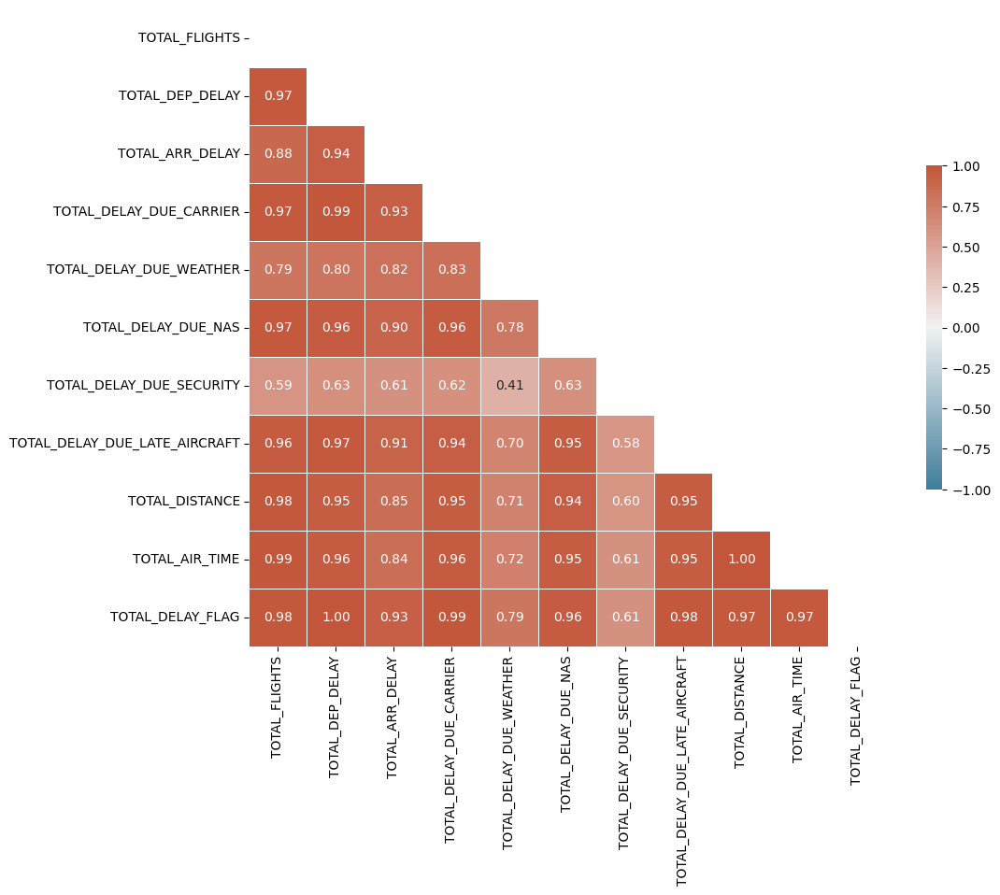

In [ ]:

correlation_matrix = tabela_origin_city[['TOTAL_FLIGHTS', 'TOTAL_DEP_DELAY', 'TOTAL_ARR_DELAY', 'TOTAL_DELAY_DUE_CARRIER', 'TOTAL_DELAY_DUE_WEATHER', 'TOTAL_DELAY_DUE_NAS', 'TOTAL_DELAY_DUE_SECURITY', 'TOTAL_DELAY_DUE_LATE_AIRCRAFT', 'TOTAL_DISTANCE', 'TOTAL_AIR_TIME', 'TOTAL_DELAY_FLAG']].corr()
corr = correlation_matrix.round(2)
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, vmin=-1, vmax=1, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt=".2f")
plt.show()


## Taxa de atrasos por ORIGIN

In [ ]:
# Calcular a taxa de atrasos por origin
tabela_origin_city['delay_rate'] = (tabela_origin_city['TOTAL_DELAY_FLAG'] / tabela_origin_city['TOTAL_FLIGHTS']) * 100

# Ordenar a tabela por 'delay_rate' em ordem decrescente
tabela_origin_city_sorted = tabela_origin_city.sort_values(by=['delay_rate'], ascending=False)

# Exibindo a taxa de atrasos por origin ordenada
print("Taxa de atrasos por operadora % (decrescente):")
print(tabela_origin_city_sorted[['ORIGIN_CITY', 'delay_rate']])




Taxa de atrasos por operadora % (decrescente):
                 ORIGIN_CITY  delay_rate
229            Pago Pago, TT   54.545455
221  North Bend/Coos Bay, OR   52.941176
245           Portsmouth, NH   52.631579
218        Niagara Falls, NY   51.851852
66                  Cody, WY   50.000000
..                       ...         ...
114          Garden City, KS    5.357143
302           Stillwater, OK    3.448276
167             Kotzebue, AK    3.389831
49                 Butte, MT    0.000000
280          Santa Maria, CA    0.000000

[333 rows x 2 columns]


## Criando tabela auxiliar | AIRLINE_NAME

In [35]:
# Agrupar por 'AIRLINE_NAME' e calcular os somatórios e contagens
tabela_airline_name = df.groupby('AIRLINE_NAME').agg({
    'FL_NUMBER': 'count',  # Contagem de 'FL_NUMBER'
    'DEP_DELAY': 'sum',  # Somatório de 'DEP_DELAY'
    'ARR_DELAY': 'sum',  # Somatório de 'ARR_DELAY'
    'DELAY_DUE_CARRIER': 'sum',  # Somatório de 'DELAY_DUE_CARRIER'
    'DELAY_DUE_WEATHER': 'sum',  # Somatório de 'DELAY_DUE_WEATHER'
    'DELAY_DUE_NAS': 'sum',  # Somatório de 'DELAY_DUE_NAS'
    'DELAY_DUE_SECURITY': 'sum',  # Somatório de 'DELAY_DUE_SECURITY'
    'DELAY_DUE_LATE_AIRCRAFT': 'sum',  # Somatório de 'DELAY_DUE_LATE_AIRCRAFT'
    'DISTANCE': 'sum',  # Somatório de 'DISTANCE'
    'AIR_TIME': 'sum',  # Somatório de 'AIR_TIME'
    'HAS_DELAY': 'sum'  # Somatório de 'DELAY_FLAG'
}).reset_index()
# Renomear as colunas para maior clareza
tabela_airline_name = tabela_airline_name.rename(columns={
    'FL_NUMBER': 'TOTAL_FLIGHTS',
    'DEP_DELAY': 'TOTAL_DEP_DELAY',
    'ARR_DELAY': 'TOTAL_ARR_DELAY',
    'DELAY_DUE_CARRIER': 'TOTAL_DELAY_DUE_CARRIER',
    'DELAY_DUE_WEATHER': 'TOTAL_DELAY_DUE_WEATHER',
    'DELAY_DUE_NAS': 'TOTAL_DELAY_DUE_NAS',
    'DELAY_DUE_SECURITY': 'TOTAL_DELAY_DUE_SECURITY',
    'DELAY_DUE_LATE_AIRCRAFT': 'TOTAL_DELAY_DUE_LATE_AIRCRAFT',
    'DISTANCE': 'TOTAL_DISTANCE',
    'AIR_TIME': 'TOTAL_AIR_TIME',
    'HAS_DELAY': 'TOTAL_DELAY_FLAG'
})
# Verificar a tabela auxiliar
print(tabela_airline_name.head())

             AIRLINE_NAME  TOTAL_FLIGHTS  TOTAL_DEP_DELAY  TOTAL_ARR_DELAY  \
0    Alaska Airlines Inc.          19421           122094            63431   
1           Allegiant Air           8478           146588           133974   
2  American Airlines Inc.          73454          1060414           792354   
3    Delta Air Lines Inc.          74419           982872           476472   
4       Endeavor Air Inc.          16637           201436           119862   

   TOTAL_DELAY_DUE_CARRIER  TOTAL_DELAY_DUE_WEATHER  TOTAL_DELAY_DUE_NAS  \
0                    58276                     7574                64573   
1                    55866                    27096                46456   
2                   445582                    56400               291922   
3                   501463                    85190               203900   
4                    79795                    29651                64925   

   TOTAL_DELAY_DUE_SECURITY  TOTAL_DELAY_DUE_LATE_AIRCRAFT  TOTAL_DISTANCE

In [ ]:
tabela_airline_name

,AIRLINE_NAME,TOTAL_FLIGHTS,TOTAL_DEP_DELAY,TOTAL_ARR_DELAY,TOTAL_DELAY_DUE_CARRIER,TOTAL_DELAY_DUE_WEATHER,TOTAL_DELAY_DUE_NAS,TOTAL_DELAY_DUE_SECURITY,TOTAL_DELAY_DUE_LATE_AIRCRAFT,TOTAL_DISTANCE,TOTAL_AIR_TIME,TOTAL_DELAY_FLAG
0,Alaska Airlines Inc.,19421,122094,63431,58276,7574,64573,749,79880,26340677,3452884,4448
1,Allegiant Air,8478,146588,133974,55866,27096,46456,211,65654,7786316,1067839,2516
2,American Airlines Inc.,73454,1060414,792354,445582,56400,291922,3567,512505,70828045,9665117,17546
3,Delta Air Lines Inc.,74419,982872,476472,501463,85190,203900,688,312789,71079245,9613340,17968
4,Endeavor Air Inc.,16637,201436,119862,79795,29651,64925,84,99638,6749275,1112050,3477
5,Envoy Air,18325,157986,134192,52089,25059,80352,318,87216,9512617,1473669,3960
6,Frontier Airlines Inc.,12828,332127,270786,115285,11442,73861,0,146082,13167348,1780111,5207
7,Hawaiian Airlines Inc.,6616,59179,60411,44384,2578,2310,62,23636,5836405,762590,1654
8,JetBlue Airways,22978,385457,242467,191090,3496,97010,2002,168151,25572468,3487472,6836
9,PSA Airlines Inc.,15165,74125,8510,41330,12501,38200,218,67079,6189224,1030781,2188


## Correlação da tabela auxiliar | AIRLINE_NAME

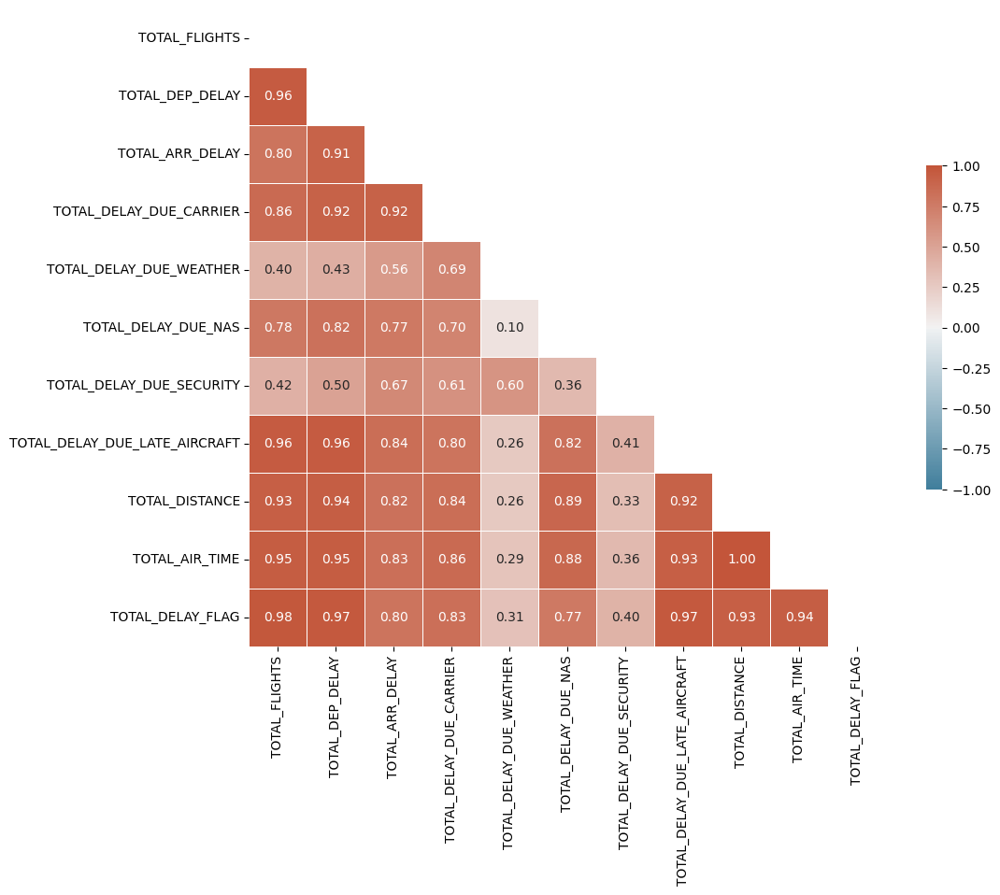

In [ ]:

correlation_matrix = tabela_airline_name[['TOTAL_FLIGHTS', 'TOTAL_DEP_DELAY', 'TOTAL_ARR_DELAY', 'TOTAL_DELAY_DUE_CARRIER', 'TOTAL_DELAY_DUE_WEATHER', 'TOTAL_DELAY_DUE_NAS', 'TOTAL_DELAY_DUE_SECURITY', 'TOTAL_DELAY_DUE_LATE_AIRCRAFT', 'TOTAL_DISTANCE', 'TOTAL_AIR_TIME', 'TOTAL_DELAY_FLAG']].corr()
corr = correlation_matrix.round(2)
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, vmin=-1, vmax=1, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt=".2f")
plt.show()


## Verifcando a normalidade dos dados

In [ ]:

# Lista de colunas a serem testadas
colunas = [
    'TOTAL_FLIGHTS', 'TOTAL_DEP_DELAY', 'TOTAL_ARR_DELAY',
    'TOTAL_DELAY_DUE_CARRIER', 'TOTAL_DELAY_DUE_WEATHER',
    'TOTAL_DELAY_DUE_NAS', 'TOTAL_DELAY_DUE_SECURITY',
    'TOTAL_DELAY_DUE_LATE_AIRCRAFT', 'TOTAL_DISTANCE',
    'TOTAL_AIR_TIME', 'TOTAL_DELAY_FLAG'
]

for coluna in colunas:
    if coluna not in tabela_airline_name.columns:
        print(f"A coluna {coluna} não está no DataFrame.")
        continue

    # Remover valores ausentes
    df_coluna = tabela_airline_name[coluna].dropna()

    # Verificar o tamanho da amostra e limitar a 5000 observações
    if len(df_coluna) > 5000:
        df_coluna = df_coluna.sample(5000, random_state=42)

    # Aplicar o teste de Shapiro-Wilk
    stat, p_valor = shapiro(df_coluna)
    print(f"\nTeste de Shapiro-Wilk para {coluna}:")
    print("Estatística de teste:", stat)
    print("p-valor:", p_valor)

    # Interpretação
    if p_valor > 0.05:
        print(f"Os dados da coluna {coluna} seguem uma distribuição normal (não rejeitamos H0).")
    else:
        print(f"Os dados da coluna {coluna} não seguem uma distribuição normal (rejeitamos H0).")


Teste de Shapiro-Wilk para TOTAL_FLIGHTS:
Estatística de teste: 0.8151955604553223
p-valor: 0.0057987854816019535
Os dados da coluna TOTAL_FLIGHTS não seguem uma distribuição normal (rejeitamos H0).

Teste de Shapiro-Wilk para TOTAL_DEP_DELAY:
Estatística de teste: 0.8553721904754639
p-valor: 0.020708076655864716
Os dados da coluna TOTAL_DEP_DELAY não seguem uma distribuição normal (rejeitamos H0).

Teste de Shapiro-Wilk para TOTAL_ARR_DELAY:
Estatística de teste: 0.9295364618301392
p-valor: 0.26855459809303284
Os dados da coluna TOTAL_ARR_DELAY seguem uma distribuição normal (não rejeitamos H0).

Teste de Shapiro-Wilk para TOTAL_DELAY_DUE_CARRIER:
Estatística de teste: 0.8101210594177246
p-valor: 0.004972543101757765
Os dados da coluna TOTAL_DELAY_DUE_CARRIER não seguem uma distribuição normal (rejeitamos H0).

Teste de Shapiro-Wilk para TOTAL_DELAY_DUE_WEATHER:
Estatística de teste: 0.6598736643791199
p-valor: 9.5499271992594e-05
Os dados da coluna TOTAL_DELAY_DUE_WEATHER não seguem

## Taxa de atrasos por AIRLINE_NAME

In [ ]:
delay_stats = df.groupby('AIRLINE_NAME').agg(
    total_delay=('HAS_DELAY', 'sum'),
    num_flights=('FL_NUMBER', 'count')
).reset_index()

# Calcular a média de atraso por voo
delay_stats['avg_delay_per_flight'] = delay_stats['total_delay'] / delay_stats['num_flights'] *100

# Ordenar as companhias aéreas pela média de atraso por voo em ordem decrescente
delay_stats = delay_stats.sort_values(by='avg_delay_per_flight', ascending=False)

# Exibir as estatísticas
print(delay_stats)


              AIRLINE_NAME  total_delay  num_flights  avg_delay_per_flight
6   Frontier Airlines Inc.         5207        12828             40.590895
13        Spirit Air Lines         7080        21348             33.164699
8          JetBlue Airways         6836        22978             29.750196
1            Allegiant Air         2516         8478             29.676811
12  Southwest Airlines Co.        30767       108999             28.226864
14   United Air Lines Inc.        14902        56102             26.562333
7   Hawaiian Airlines Inc.         1654         6616             25.000000
3     Delta Air Lines Inc.        17968        74419             24.144372
2   American Airlines Inc.        17546        73454             23.887059
0     Alaska Airlines Inc.         4448        19421             22.903043
11   SkyWest Airlines Inc.        10765        48378             22.251850
5                Envoy Air         3960        18325             21.609823
4        Endeavor Air Inc

In [ ]:
# Calcular os quartis para TOTAL_FLIGHTS
quartis_TOTAL_FLIGHTS = tabela_airline_name['TOTAL_FLIGHTS'].quantile([0.25, 0.75])
print("Quartis para TOTAL_FLIGHTS:")
print(quartis_TOTAL_FLIGHTS)


Quartis para TOTAL_FLIGHTS:
0.25    15901.0
0.75    52240.0
Name: TOTAL_FLIGHTS, dtype: float64


In [ ]:
# Definir os grupos com base nos quartis calculados
tabela_airline_name['flight_group'] = pd.cut(tabela_airline_name['TOTAL_FLIGHTS'],
                                             bins=[-float('inf'), quartis_TOTAL_FLIGHTS[0.75], float('inf')],
                                             labels=['Baixo', 'Alto'])

print("DataFrame com grupos definidos:")
print(tabela_airline_name)


DataFrame com grupos definidos:
              AIRLINE_NAME  TOTAL_FLIGHTS  TOTAL_DEP_DELAY  TOTAL_ARR_DELAY  \
0     Alaska Airlines Inc.          19421           122094            63431   
1            Allegiant Air           8478           146588           133974   
2   American Airlines Inc.          73454          1060414           792354   
3     Delta Air Lines Inc.          74419           982872           476472   
4        Endeavor Air Inc.          16637           201436           119862   
5                Envoy Air          18325           157986           134192   
6   Frontier Airlines Inc.          12828           332127           270786   
7   Hawaiian Airlines Inc.           6616            59179            60411   
8          JetBlue Airways          22978           385457           242467   
9        PSA Airlines Inc.          15165            74125             8510   
10        Republic Airline          24049            93900           -39000   
11   SkyWest Airline

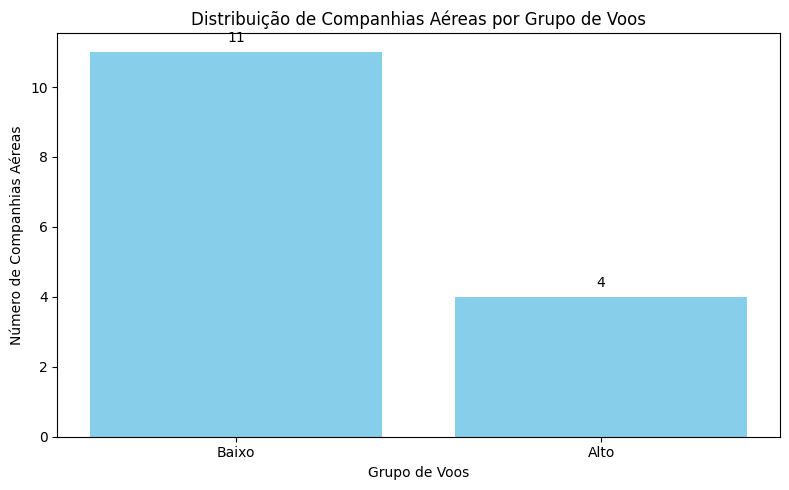

In [ ]:

# Contar a quantidade de companhias aéreas em cada grupo
group_counts = tabela_airline_name['flight_group'].value_counts()

# Plotar o gráfico de barras
plt.figure(figsize=(8, 5))
bars = plt.bar(group_counts.index, group_counts.values, color='skyblue')
plt.xlabel('Grupo de Voos')
plt.ylabel('Número de Companhias Aéreas')
plt.title('Distribuição de Companhias Aéreas por Grupo de Voos')

# Adicionar os valores acima das barras
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.2, int(yval), ha='center', va='bottom', fontsize=10)

plt.tight_layout()
plt.show()


##  Hipótese 3 | Teste de Mannwhitneyu U | Taxa de atrasos

In [ ]:
from scipy.stats import mannwhitneyu

# Selecionar os grupos
grupo_baixo = tabela_airline_name[tabela_airline_name['flight_group'] == 'Baixo']['TOTAL_DELAY_FLAG']
grupo_alto = tabela_airline_name[tabela_airline_name['flight_group'] == 'Alto']['TOTAL_DELAY_FLAG']

# Teste de Mann-Whitney
stat, p_value = mannwhitneyu(grupo_baixo, grupo_alto)
print(f'Estatística do Teste de Mann-Whitney: {stat}, Valor-p: {p_value}')

# Interpretação do resultado
if p_value < 0.05:
    print("Há uma diferença significativa nas médias de atraso entre os grupos 'Baixo' e 'Alto'.")
else:
    print("Não há diferença significativa nas médias de atraso entre os grupos 'Baixo' e 'Alto'.")


Estatística do Teste de Mann-Whitney: 0.0, Valor-p: 0.0014652014652014652
Há uma diferença significativa nas médias de atraso entre os grupos 'Baixo' e 'Alto'.


## Criando tabela auxiliar "DEST_CITY"




In [ ]:
# Agrupar por 'DEST_CITY' e calcular os somatórios e contagens
tabela_dest_city = df.groupby('DEST_CITY').agg({
    'FL_NUMBER': 'count',  # Contagem de 'FL_NUMBER'
    'DEP_DELAY': 'sum',  # Somatório de 'DEP_DELAY'
    'ARR_DELAY': 'sum',  # Somatório de 'ARR_DELAY'
    'DELAY_DUE_CARRIER': 'sum',  # Somatório de 'DELAY_DUE_CARRIER'
    'DELAY_DUE_WEATHER': 'sum',  # Somatório de 'DELAY_DUE_WEATHER'
    'DELAY_DUE_NAS': 'sum',  # Somatório de 'DELAY_DUE_NAS'
    'DELAY_DUE_SECURITY': 'sum',  # Somatório de 'DELAY_DUE_SECURITY'
    'DELAY_DUE_LATE_AIRCRAFT': 'sum',  # Somatório de 'DELAY_DUE_LATE_AIRCRAFT'
    'DISTANCE': 'sum',  # Somatório de 'DISTANCE'
    'AIR_TIME': 'sum',  # Somatório de 'AIR_TIME'
    'DELAY_FLAG': 'sum'  # Somatório de 'DELAY_FLAG'
}).reset_index()
# Renomear as colunas para maior clareza
tabela_dest_city = tabela_dest_city.rename(columns={
    'FL_NUMBER': 'TOTAL_FLIGHTS',
    'DEP_DELAY': 'TOTAL_DEP_DELAY',
    'ARR_DELAY': 'TOTAL_ARR_DELAY',
    'DELAY_DUE_CARRIER': 'TOTAL_DELAY_DUE_CARRIER',
    'DELAY_DUE_WEATHER': 'TOTAL_DELAY_DUE_WEATHER',
    'DELAY_DUE_NAS': 'TOTAL_DELAY_DUE_NAS',
    'DELAY_DUE_SECURITY': 'TOTAL_DELAY_DUE_SECURITY',
    'DELAY_DUE_LATE_AIRCRAFT': 'TOTAL_DELAY_DUE_LATE_AIRCRAFT',
    'DISTANCE': 'TOTAL_DISTANCE',
    'AIR_TIME': 'TOTAL_AIR_TIME',
    'DELAY_FLAG': 'TOTAL_DELAY_FLAG'
})
# Verificar a tabela auxiliar
print(tabela_dest_city.head())

         DEST_CITY  TOTAL_FLIGHTS  TOTAL_DEP_DELAY  TOTAL_ARR_DELAY  \
0     Aberdeen, SD             59              -46             -863   
1      Abilene, TX            105              484              614   
2  Adak Island, AK              6              -46             -109   
3    Aguadilla, PR            249             5237             3860   
4        Akron, OH            193              900              183   

   TOTAL_DELAY_DUE_CARRIER  TOTAL_DELAY_DUE_WEATHER  TOTAL_DELAY_DUE_NAS  \
0                       50                      126                    0   
1                      188                      103                  186   
2                        0                        0                    0   
3                     2765                        0                 1043   
4                      704                       92                  373   

   TOTAL_DELAY_DUE_SECURITY  TOTAL_DELAY_DUE_LATE_AIRCRAFT  TOTAL_DISTANCE  \
0                         0           

In [ ]:
tabela_dest_city

,DEST_CITY,TOTAL_FLIGHTS,TOTAL_DEP_DELAY,TOTAL_ARR_DELAY,TOTAL_DELAY_DUE_CARRIER,TOTAL_DELAY_DUE_WEATHER,TOTAL_DELAY_DUE_NAS,TOTAL_DELAY_DUE_SECURITY,TOTAL_DELAY_DUE_LATE_AIRCRAFT,TOTAL_DISTANCE,TOTAL_AIR_TIME,TOTAL_DELAY_FLAG
0,"Aberdeen, SD",59,-46,-863,50,126,0,0,0,15163,2731,6
1,"Abilene, TX",105,484,614,188,103,186,0,362,16590,3534,17
2,"Adak Island, AK",6,-46,-109,0,0,0,0,0,7152,978,0
3,"Aguadilla, PR",249,5237,3860,2765,0,1043,55,1033,316341,37887,88
4,"Akron, OH",193,900,183,704,92,373,0,708,95587,14431,46
...,...,...,...,...,...,...,...,...,...,...,...,...
328,"Wilmington, NC",455,1744,-1756,1061,81,643,0,1802,176657,27380,59
329,"Worcester, MA",138,1910,1000,1075,0,131,5,1157,51385,7882,28
330,"Wrangell, AK",54,42,-146,17,91,46,0,289,3102,950,10
331,"Yakutat, AK",57,29,-69,23,80,20,0,307,11691,2204,8


## Teste shapiro

In [ ]:
from scipy.stats import shapiro
# Lista de colunas a serem testadas
colunas = [
    'TOTAL_FLIGHTS', 'TOTAL_DEP_DELAY', 'TOTAL_ARR_DELAY',
    'TOTAL_DELAY_DUE_CARRIER', 'TOTAL_DELAY_DUE_WEATHER',
    'TOTAL_DELAY_DUE_NAS', 'TOTAL_DELAY_DUE_SECURITY',
    'TOTAL_DELAY_DUE_LATE_AIRCRAFT', 'TOTAL_DISTANCE',
    'TOTAL_AIR_TIME', 'TOTAL_DELAY_FLAG'
]

for coluna in colunas:
    if coluna not in tabela_dest_city.columns:
        print(f"A coluna {coluna} não está no DataFrame.")
        continue

    # Remover valores ausentes
    df_coluna = tabela_dest_city[coluna].dropna()

    # Verificar o tamanho da amostra e limitar a 5000 observações
    if len(df_coluna) > 5000:
        df_coluna = df_coluna.sample(5000, random_state=42)

    # Aplicar o teste de Shapiro-Wilk
    stat, p_valor = shapiro(df_coluna)
    print(f"\nTeste de Shapiro-Wilk para {coluna}:")
    print("Estatística de teste:", stat)
    print("p-valor:", p_valor)

    # Interpretação
    if p_valor > 0.05:
        print(f"Os dados da coluna {coluna} seguem uma distribuição normal (não rejeitamos H0).")
    else:
        print(f"Os dados da coluna {coluna} não seguem uma distribuição normal (rejeitamos H0).")




Teste de Shapiro-Wilk para TOTAL_FLIGHTS:
Estatística de teste: 0.4410870671272278
p-valor: 7.030865870742785e-31
Os dados da coluna TOTAL_FLIGHTS não seguem uma distribuição normal (rejeitamos H0).

Teste de Shapiro-Wilk para TOTAL_DEP_DELAY:
Estatística de teste: 0.4155135154724121
p-valor: 2.0596473638695445e-31
Os dados da coluna TOTAL_DEP_DELAY não seguem uma distribuição normal (rejeitamos H0).

Teste de Shapiro-Wilk para TOTAL_ARR_DELAY:
Estatística de teste: 0.4000225067138672
p-valor: 9.99569983827659e-32
Os dados da coluna TOTAL_ARR_DELAY não seguem uma distribuição normal (rejeitamos H0).

Teste de Shapiro-Wilk para TOTAL_DELAY_DUE_CARRIER:
Estatística de teste: 0.417880654335022
p-valor: 2.3033412136283444e-31
Os dados da coluna TOTAL_DELAY_DUE_CARRIER não seguem uma distribuição normal (rejeitamos H0).

Teste de Shapiro-Wilk para TOTAL_DELAY_DUE_WEATHER:
Estatística de teste: 0.39160048961639404
p-valor: 6.78921514771515e-32
Os dados da coluna TOTAL_DELAY_DUE_WEATHER não 

## Correlação da tabela auxiliar | DEST_CITY


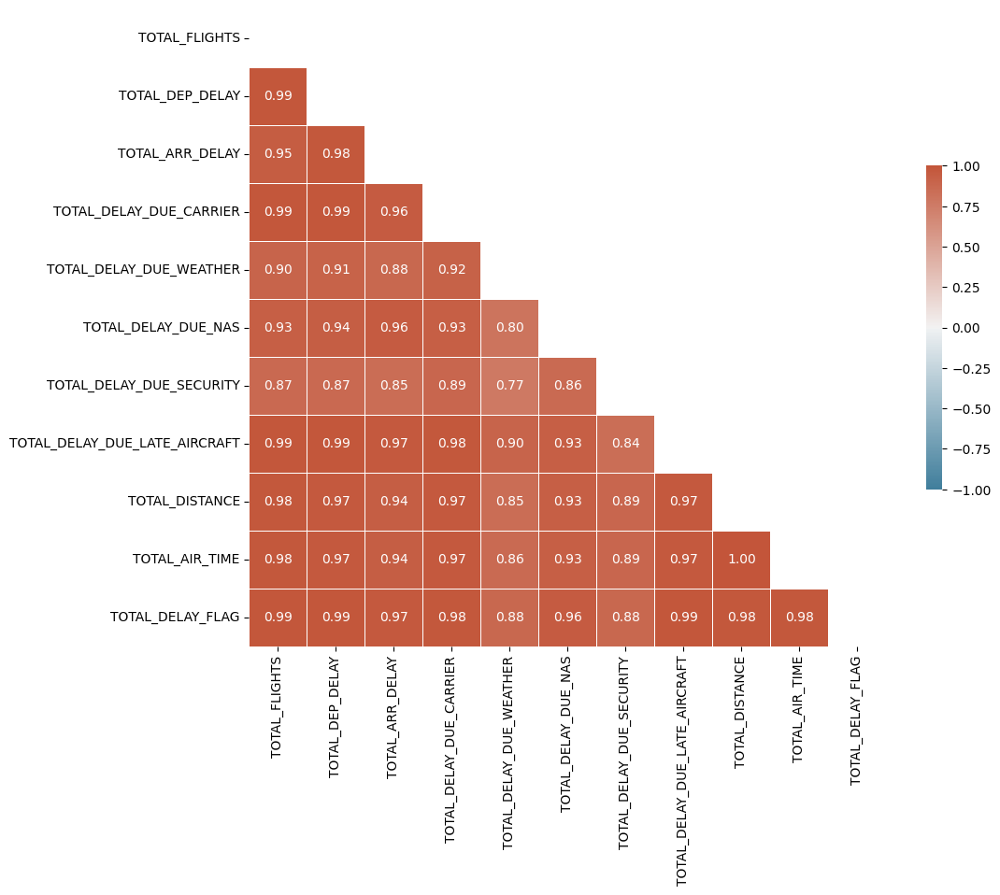

In [ ]:

correlation_matrix = tabela_dest_city[['TOTAL_FLIGHTS', 'TOTAL_DEP_DELAY', 'TOTAL_ARR_DELAY', 'TOTAL_DELAY_DUE_CARRIER', 'TOTAL_DELAY_DUE_WEATHER', 'TOTAL_DELAY_DUE_NAS', 'TOTAL_DELAY_DUE_SECURITY', 'TOTAL_DELAY_DUE_LATE_AIRCRAFT', 'TOTAL_DISTANCE', 'TOTAL_AIR_TIME', 'TOTAL_DELAY_FLAG']].corr()
corr = correlation_matrix.round(2)
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, vmin=-1, vmax=1, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt=".2f")
plt.show()


## Taxa de atrasos por DEST_CITY

In [ ]:
# Calcular a taxa de atrasos por destino
tabela_dest_city['delay_rate'] = (tabela_dest_city['TOTAL_DELAY_FLAG'] / tabela_dest_city['TOTAL_FLIGHTS']) * 100

# Ordenar a tabela por 'delay_rate' em ordem decrescente
tabela_dest_city_sorted = tabela_dest_city.sort_values(by=['delay_rate'], ascending=False)

# Exibindo a taxa de atrasos por destino ordenada
print("Taxa de atrasos por operadora % (decrescente):")
print(tabela_dest_city_sorted[['DEST_CITY', 'delay_rate']])

Taxa de atrasos por operadora % (decrescente):
                   DEST_CITY  delay_rate
229            Pago Pago, TT   63.636364
221  North Bend/Coos Bay, OR   58.823529
17                 Aspen, CO   46.629986
248                Provo, UT   46.258503
106                Flint, MI   44.936709
..                       ...         ...
241            Pocatello, ID    3.225806
280          Santa Maria, CA    0.000000
2            Adak Island, AK    0.000000
123           Greenville, NC    0.000000
66                  Cody, WY    0.000000

[333 rows x 2 columns]


## Criando tabela auxiliar "FLIGHT_ROUTE"

In [36]:
# Agrupar por 'ORIGIN_CITY' e calcular os somatórios e contagens
tabela_flight_route = df.groupby('FLIGHT_ROUTE').agg({
    'FL_NUMBER': 'count',  # Contagem de 'FL_NUMBER'
    'DEP_DELAY': 'sum',  # Somatório de 'DEP_DELAY'
    'ARR_DELAY': 'sum',  # Somatório de 'ARR_DELAY'
    'DELAY_DUE_CARRIER': 'sum',  # Somatório de 'DELAY_DUE_CARRIER'
    'DELAY_DUE_WEATHER': 'sum',  # Somatório de 'DELAY_DUE_WEATHER'
    'DELAY_DUE_NAS': 'sum',  # Somatório de 'DELAY_DUE_NAS'
    'DELAY_DUE_SECURITY': 'sum',  # Somatório de 'DELAY_DUE_SECURITY'
    'DELAY_DUE_LATE_AIRCRAFT': 'sum',  # Somatório de 'DELAY_DUE_LATE_AIRCRAFT'
    'DISTANCE': 'sum',  # Somatório de 'DISTANCE'
    'AIR_TIME': 'sum',  # Somatório de 'AIR_TIME'
    'HAS_DELAY': 'sum'  # Somatório de 'DELAY_FLAG'
}).reset_index()
# Renomear as colunas para maior clareza
tabela_flight_route = tabela_flight_route.rename(columns={
    'FL_NUMBER': 'TOTAL_FLIGHTS',
    'DEP_DELAY': 'TOTAL_DEP_DELAY',
    'ARR_DELAY': 'TOTAL_ARR_DELAY',
    'DELAY_DUE_CARRIER': 'TOTAL_DELAY_DUE_CARRIER',
    'DELAY_DUE_WEATHER': 'TOTAL_DELAY_DUE_WEATHER',
    'DELAY_DUE_NAS': 'TOTAL_DELAY_DUE_NAS',
    'DELAY_DUE_SECURITY': 'TOTAL_DELAY_DUE_SECURITY',
    'DELAY_DUE_LATE_AIRCRAFT': 'TOTAL_DELAY_DUE_LATE_AIRCRAFT',
    'DISTANCE': 'TOTAL_DISTANCE',
    'AIR_TIME': 'TOTAL_AIR_TIME',
    'HAS_DELAY': 'TOTAL_DELAY_FLAG'
})
# Verificar a tabela auxiliar
print(tabela_flight_route.head())

                          FLIGHT_ROUTE  TOTAL_FLIGHTS  TOTAL_DEP_DELAY  \
0       Aberdeen, SD - Minneapolis, MN             58              543   
1  Abilene, TX - Dallas/Fort Worth, TX            103             1627   
2      Adak Island, AK - Anchorage, AK              6              -50   
3  Aguadilla, PR - Fort Lauderdale, FL             42              849   
4         Aguadilla, PR - New York, NY             62              257   

   TOTAL_ARR_DELAY  TOTAL_DELAY_DUE_CARRIER  TOTAL_DELAY_DUE_WEATHER  \
0              525                      338                      551   
1              835                      335                      155   
2              -50                        0                        0   
3              668                       69                        5   
4              221                      112                        5   

   TOTAL_DELAY_DUE_NAS  TOTAL_DELAY_DUE_SECURITY  \
0                    0                         0   
1                 

In [ ]:
tabela_flight_route

,FLIGHT_ROUTE,TOTAL_FLIGHTS,TOTAL_DEP_DELAY,TOTAL_ARR_DELAY,TOTAL_DELAY_DUE_CARRIER,TOTAL_DELAY_DUE_WEATHER,TOTAL_DELAY_DUE_NAS,TOTAL_DELAY_DUE_SECURITY,TOTAL_DELAY_DUE_LATE_AIRCRAFT,TOTAL_DISTANCE,TOTAL_AIR_TIME,TOTAL_DELAY_FLAG
0,"Aberdeen, SD - Minneapolis, MN",58,543,525,338,551,0,0,0,14906,2738,7
1,"Abilene, TX - Dallas/Fort Worth, TX",103,1627,835,335,155,270,0,992,16274,3379,24
2,"Adak Island, AK - Anchorage, AK",6,-50,-50,0,0,25,39,0,7152,879,1
3,"Aguadilla, PR - Fort Lauderdale, FL",42,849,668,69,5,155,0,630,41244,5615,18
4,"Aguadilla, PR - New York, NY",62,257,221,112,5,135,0,294,97712,13074,13
...,...,...,...,...,...,...,...,...,...,...,...,...
5143,"Wrangell, AK - Petersburg, AK",27,-69,-81,7,31,1,0,155,837,344,5
5144,"Yakutat, AK - Cordova, AK",29,-35,-201,0,0,2,0,148,6177,1092,7
5145,"Yakutat, AK - Juneau, AK",26,-437,-521,0,0,0,0,81,5148,899,1
5146,"Yuma, AZ - Dallas/Fort Worth, TX",30,582,200,335,70,0,0,81,30660,3654,10


## Taxa de atrasos por rota

In [ ]:
tabela_flight_route['delay_rate'] = (tabela_flight_route['TOTAL_DELAY_FLAG'] / tabela_flight_route['TOTAL_FLIGHTS']) * 100
tabela_flight_route_sorted = tabela_flight_route.sort_values(by=['delay_rate'], ascending=False)

print("Taxa de atrasos por rotas % (decrescente):")
print(tabela_flight_route_sorted[['FLIGHT_ROUTE', 'delay_rate']])


Taxa de atrasos por rotas % (decrescente):
                                          FLIGHT_ROUTE  delay_rate
3607                     Philadelphia, PA - Bangor, ME       100.0
4296                    San Francisco, CA - Hayden, CO       100.0
1376                           Denver, CO - Albany, NY       100.0
3307                          Newark, NJ - Oakland, CA       100.0
5099  West Palm Beach/Palm Beach, FL - Los Angeles, CA       100.0
...                                                ...         ...
2389                            Kona, HI - Chicago, IL         0.0
2386    Knoxville, TN - West Palm Beach/Palm Beach, FL         0.0
4226              San Diego, CA - Colorado Springs, CO         0.0
2373                       Knoxville, TN - Houston, TX         0.0
2521                    Las Vegas, NV - South Bend, IN         0.0

[5148 rows x 2 columns]


## Correlação tabela auxiliar | FLIGHT_ROUTE

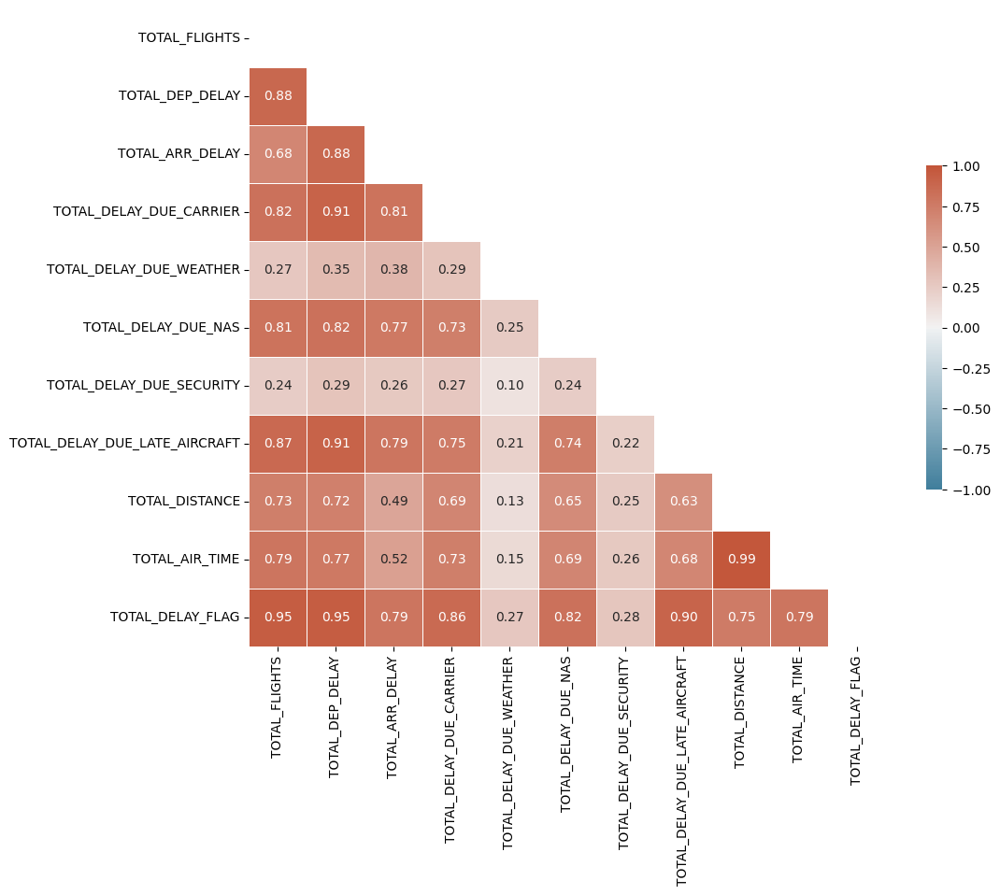

In [ ]:

correlation_matrix = tabela_flight_route[['TOTAL_FLIGHTS', 'TOTAL_DEP_DELAY', 'TOTAL_ARR_DELAY', 'TOTAL_DELAY_DUE_CARRIER', 'TOTAL_DELAY_DUE_WEATHER', 'TOTAL_DELAY_DUE_NAS', 'TOTAL_DELAY_DUE_SECURITY', 'TOTAL_DELAY_DUE_LATE_AIRCRAFT', 'TOTAL_DISTANCE', 'TOTAL_AIR_TIME', 'TOTAL_DELAY_FLAG']].corr()
corr = correlation_matrix.round(2)
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, vmin=-1, vmax=1, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt=".2f")
plt.show()



## Média de atrasos por voo

In [ ]:
delay_stats = df.groupby('FLIGHT_ROUTE').agg(
    total_delay=('DEP_DELAY', 'sum'),
    num_flights=('FL_NUMBER', 'count')
).reset_index()

# Calcular a média de atraso por voo
delay_stats['avg_delay_per_flight'] = delay_stats['total_delay'] / delay_stats['num_flights'] *100

# Ordenar as companhias aéreas pela média de atraso por voo em ordem decrescente
delay_stats = delay_stats.sort_values(by='avg_delay_per_flight', ascending=False)

# Exibir as estatísticas
print(delay_stats)

                           FLIGHT_ROUTE  total_delay  num_flights  \
4969        Valparaiso, FL - Boston, MA         1504            1   
581         Boston, MA - Valparaiso, FL         1503            1   
3027  Montrose/Delta, CO - New York, NY         1183            1   
442       Baton Rouge, LA - Houston, TX         1326            3   
327          Austin, TX - Knoxville, TN          386            1   
...                                 ...          ...          ...   
5145           Yakutat, AK - Juneau, AK         -437           26   
3593            Peoria, IL - Denver, CO          -17            1   
2975   Minneapolis, MN - Valparaiso, FL         -140            8   
1108        Columbus, OH - Savannah, GA         -169            9   
1727  Fayetteville, AR - Valparaiso, FL          -20            1   

      avg_delay_per_flight  
4969              150400.0  
581               150300.0  
3027              118300.0  
442                44200.0  
327                38600.0

## Regressão linear

Coeficiente de correlação: PearsonRResult(statistic=0.6964228294328917, pvalue=0.0)


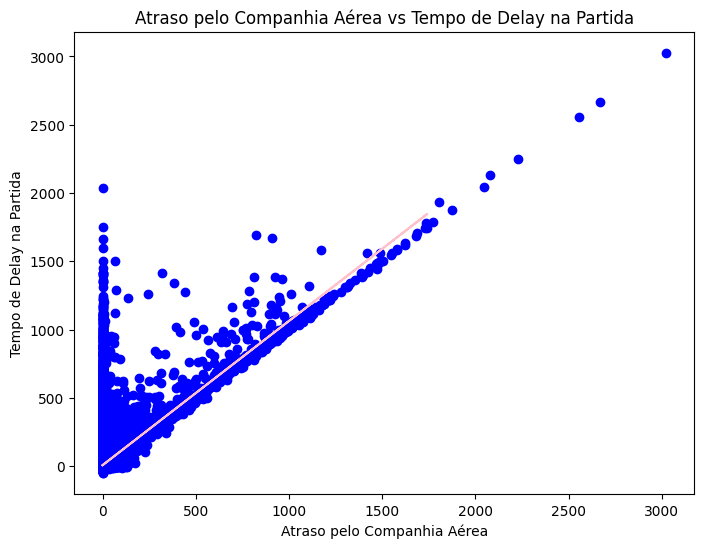

Coeficiente r2: 0.4556794891343051


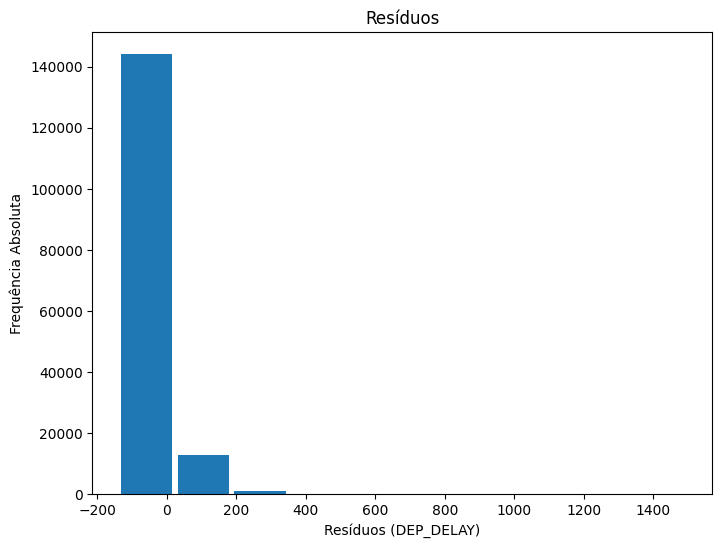

In [37]:
from scipy.stats import pearsonr
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
# Plote o Gráfico de Dispersão e Calcule o índice de correlação
X = df['DELAY_DUE_CARRIER'].values
Y = df['DEP_DELAY'].values

# Calcule o índice de correlação
r = pearsonr(X, Y)
print(f'Coeficiente de correlação: {r}')

# Separe dados de treino e teste
x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

# Redimensione os dados para fazer a regressão linear
x_train = x_train.reshape(-1, 1)
x_test = x_test.reshape(-1, 1)

# Treine o modelo
reg = LinearRegression()
reg.fit(x_train, y_train)
pred = reg.predict(x_test)

# Ajuste o tamanho da figura
plt.figure(figsize=(8, 6))
# Plotando o Gráfico de Dispersão
plt.scatter(X, Y, color="blue")
plt.plot(x_test, pred, color="pink")
plt.title("Atraso pelo Companhia Aérea vs Tempo de Delay na Partida")
plt.xlabel("Atraso pelo Companhia Aérea")
plt.ylabel("Tempo de Delay na Partida")
plt.show()

# Verifique a representação do modelo
r_squared = r2_score(y_test, pred)
print(f'Coeficiente r2: {r_squared}')

# Calcule os resíduos
residual = y_test - pred

# Ajuste o tamanho da figura
plt.figure(figsize=(8, 6))
# Plotando o histograma dos resíduos
plt.hist(residual, rwidth=0.9)
plt.title('Resíduos')
plt.xlabel('Resíduos (DEP_DELAY)')
plt.ylabel('Frequência Absoluta')
plt.show()


Coeficiente de correlação: PearsonRResult(statistic=0.3276401089807217, pvalue=0.0)


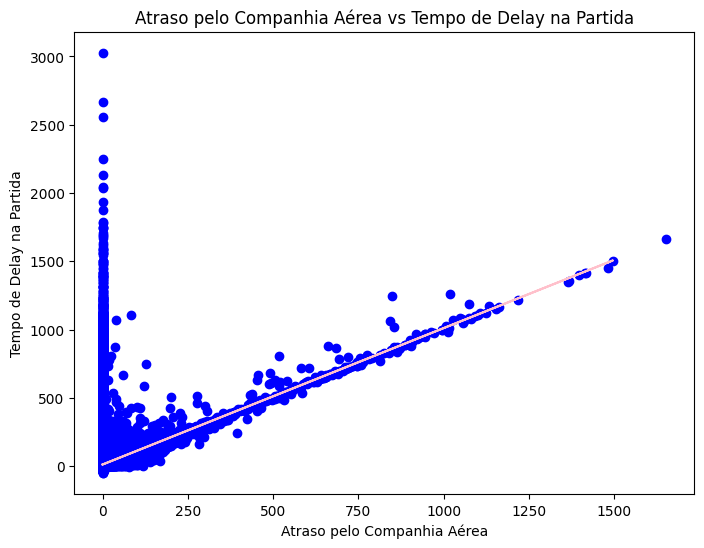

Coeficiente r2: 0.10018758510694203


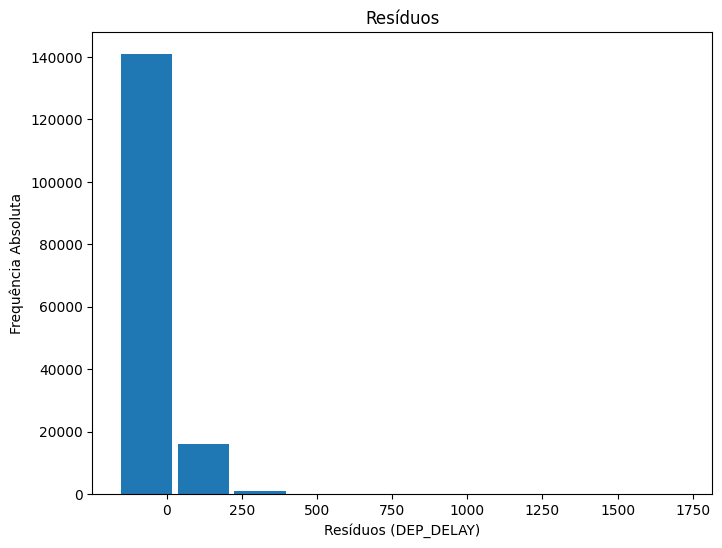

In [38]:

# Plotando o Gráfico de Dispersão e Calculando o índice de correlação
X = df['DELAY_DUE_WEATHER'].values
Y = df['DEP_DELAY'].values

# Calculando o índice de correlação
r = pearsonr(X, Y)
print(f'Coeficiente de correlação: {r}')

# Separarando os dados de treino e teste
x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

# Redimensionando os dados para fazer a regressão linear
x_train = x_train.reshape(-1, 1)
x_test = x_test.reshape(-1, 1)

# Treinando o modelo
reg = LinearRegression()
reg.fit(x_train, y_train)
pred = reg.predict(x_test)

# Ajuste o tamanho da figura
plt.figure(figsize=(8, 6))  # Defina a largura e altura desejadas
# Plotando o Gráfico de Dispersão
plt.scatter(X, Y, color="blue")
plt.plot(x_test, pred, color="pink")
plt.title("Atraso pelo Companhia Aérea vs Tempo de Delay na Partida")
plt.xlabel("Atraso pelo Companhia Aérea")
plt.ylabel("Tempo de Delay na Partida")
plt.show()

# Verificando a representação do modelo
r_squared = r2_score(y_test, pred)
print(f'Coeficiente r2: {r_squared}')

# Calculando os resíduos
residual = y_test - pred

# Ajustando o tamanho da figura
plt.figure(figsize=(8, 6))
# Plotando o histograma dos resíduos
plt.hist(residual, rwidth=0.9)
plt.title('Resíduos')
plt.xlabel('Resíduos (DEP_DELAY)')
plt.ylabel('Frequência Absoluta')
plt.show()


Coeficiente de correlação: PearsonRResult(statistic=0.2694818739336429, pvalue=0.0)


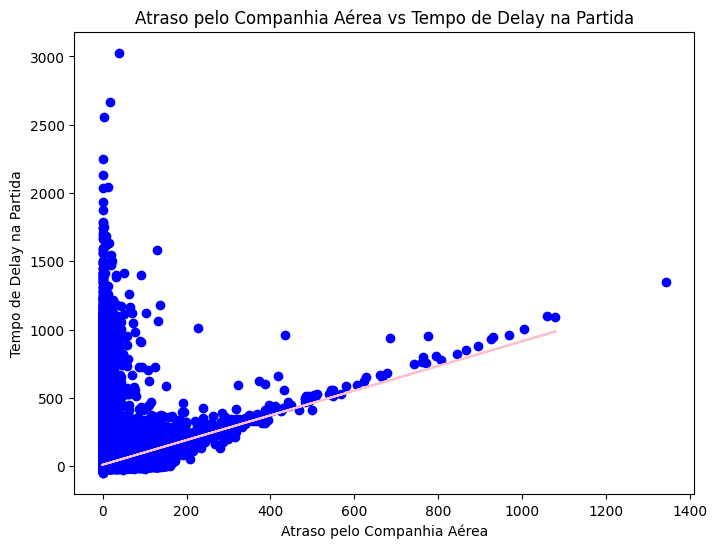

Coeficiente r2: 0.07744596184405139


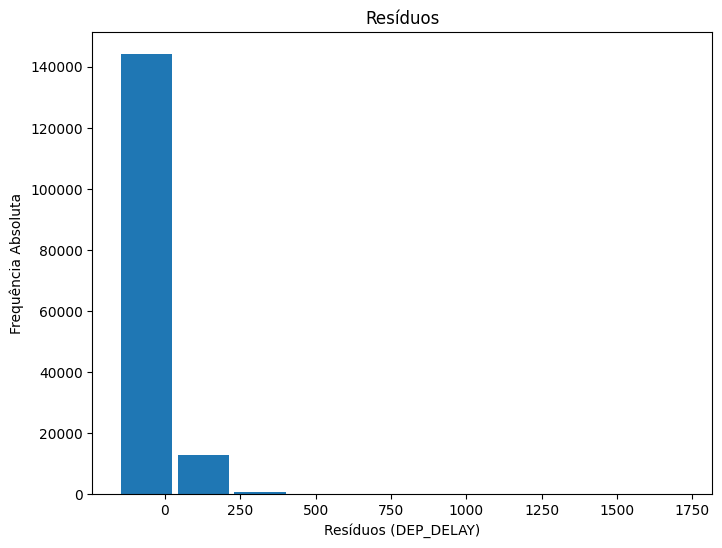

In [39]:

# Plotando o Gráfico de Dispersão e Calculando o índice de correlação
X = df['DELAY_DUE_NAS'].values
Y = df['DEP_DELAY'].values

# Calculando o índice de correlação
r = pearsonr(X, Y)
print(f'Coeficiente de correlação: {r}')

# Separarando os dados de treino e teste
x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

# Redimensionando os dados para fazer a regressão linear
x_train = x_train.reshape(-1, 1)
x_test = x_test.reshape(-1, 1)

# Treinando o modelo
reg = LinearRegression()
reg.fit(x_train, y_train)
pred = reg.predict(x_test)

# Ajuste o tamanho da figura
plt.figure(figsize=(8, 6))  # Defina a largura e altura desejadas
# Plotando o Gráfico de Dispersão
plt.scatter(X, Y, color="blue")
plt.plot(x_test, pred, color="pink")
plt.title("Atraso pelo Companhia Aérea vs Tempo de Delay na Partida")
plt.xlabel("Atraso pelo Companhia Aérea")
plt.ylabel("Tempo de Delay na Partida")
plt.show()

# Verificando a representação do modelo
r_squared = r2_score(y_test, pred)
print(f'Coeficiente r2: {r_squared}')

# Calculando os resíduos
residual = y_test - pred

# Ajustando o tamanho da figura
plt.figure(figsize=(8, 6))
# Plotando o histograma dos resíduos
plt.hist(residual, rwidth=0.9)
plt.title('Resíduos')
plt.xlabel('Resíduos (DEP_DELAY)')
plt.ylabel('Frequência Absoluta')
plt.show()


Coeficiente de correlação: 0.9663163069527376


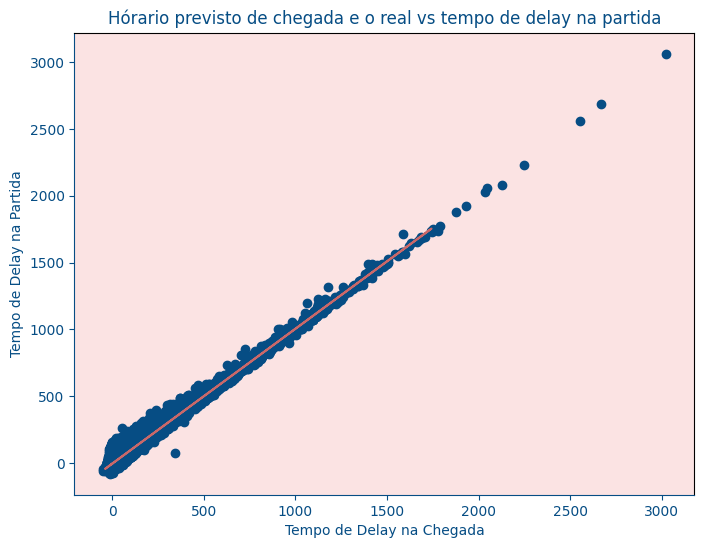

Coeficiente r2: 0.9288684710692274


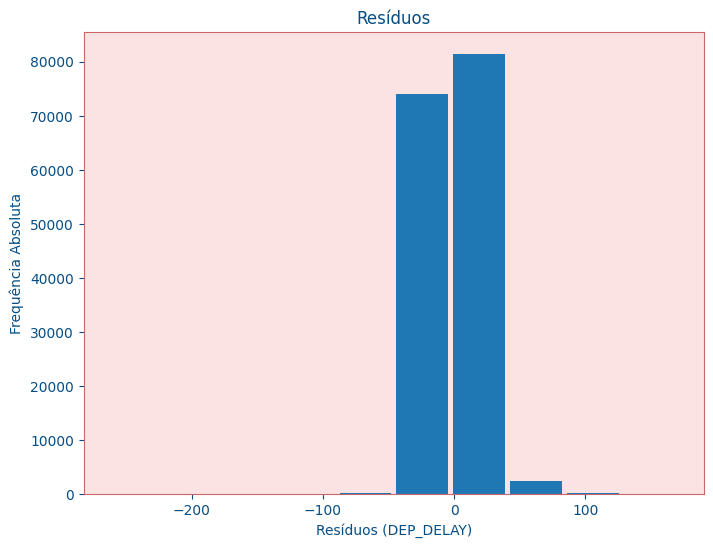

In [40]:
# Plotando o Gráfico de Dispersão e Calculando o índice de correlação
X = df['DEP_DELAY'].values
Y = df['ARR_DELAY'].values

# Calculando o índice de correlação
r, _ = pearsonr(X, Y)
print(f'Coeficiente de correlação: {r}')

# Separarando os dados de treino e teste
x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

# Redimensionando os dados para fazer a regressão linear
x_train = x_train.reshape(-1, 1)
x_test = x_test.reshape(-1, 1)

# Treinando o modelo
reg = LinearRegression()
reg.fit(x_train, y_train)
pred = reg.predict(x_test)

# Ajuste o tamanho da figura
fig, ax = plt.subplots(figsize=(8, 6))
ax.set_facecolor("#fbe3e3")
# Plotando o Gráfico de Dispersão
ax.scatter(X, Y, color="#064d84")
ax.plot(x_test, pred, color="#c96869")
# Ajustando os títulos e as labels
ax.set_title("Hórario previsto de chegada e o real vs tempo de delay na partida", color='#064d84')
ax.set_xlabel("Tempo de Delay na Chegada", color='#064d84')
ax.set_ylabel("Tempo de Delay na Partida", color='#064d84')

# Ajustando a cor dos eixos
ax.tick_params(axis='x', colors='#064d84')
ax.tick_params(axis='y', colors='#064d84')
ax.spines['bottom'].set_color('#064d84')
ax.spines['left'].set_color('#064d84')

plt.show()

# Verificando a representação do modelo
r_squared = r2_score(y_test, pred)
print(f'Coeficiente r2: {r_squared}')

# Calculando os resíduos
residual = y_test - pred

# Ajustando o tamanho da figura
fig, ax = plt.subplots(figsize=(8, 6))
ax.set_facecolor("#fbe3e3")
# Plotando o histograma dos resíduos
ax.hist(residual, rwidth=0.9)
# Ajustando os títulos e as labels
ax.set_title('Resíduos', color='#064d84')
ax.set_xlabel('Resíduos (DEP_DELAY)', color='#064d84')
ax.set_ylabel('Frequência Absoluta', color='#064d84')

# Ajustando a cor dos eixos
ax.tick_params(axis='x', colors='#064d84')
ax.tick_params(axis='y', colors='#064d84')
ax.spines['bottom'].set_color('#064d84')
ax.spines['left'].set_color('#064d84')

# Ajustando a borda da caixa de texto para rosa
for spine in ax.spines.values():
    spine.set_edgecolor("#c96869")

plt.show()



Coeficiente de correlação: PearsonRResult(statistic=0.025763771500434633, pvalue=4.1264536104267305e-78)


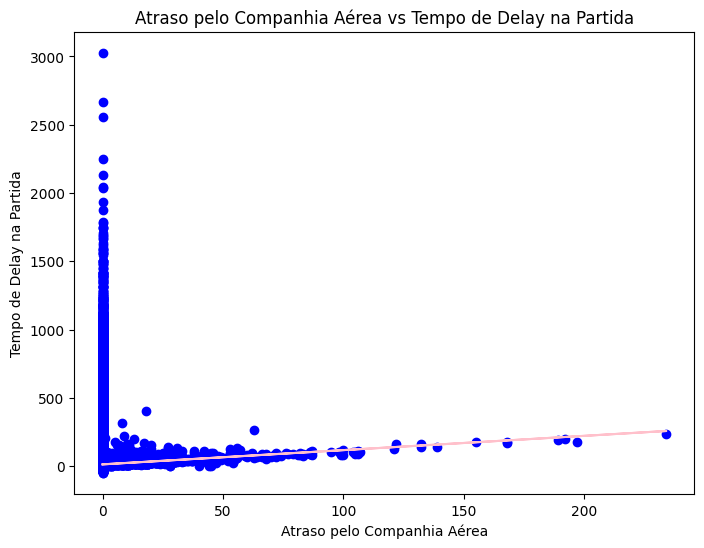

Coeficiente r2: 0.0007741534173013598


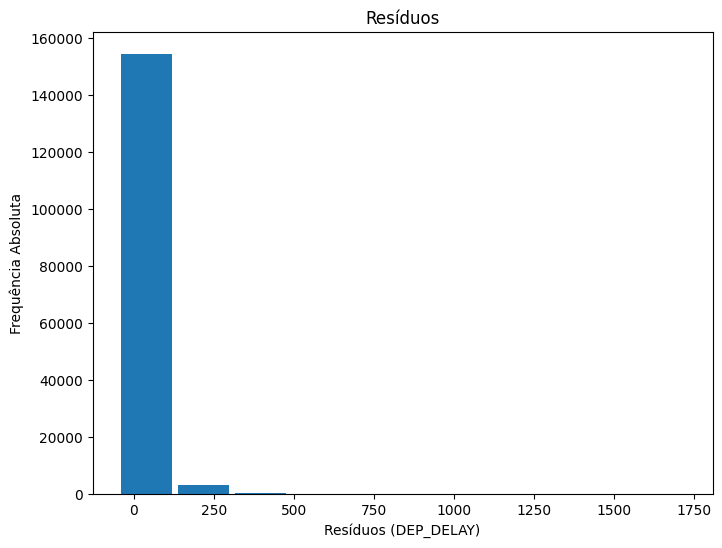

In [41]:
# Plotando o Gráfico de Dispersão e Calculando o índice de correlação
X = df['DELAY_DUE_SECURITY'].values
Y = df['DEP_DELAY'].values

# Calculando o índice de correlação
r = pearsonr(X, Y)
print(f'Coeficiente de correlação: {r}')

# Separarando os dados de treino e teste
x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

# Redimensionando os dados para fazer a regressão linear
x_train = x_train.reshape(-1, 1)
x_test = x_test.reshape(-1, 1)

# Treinando o modelo
reg = LinearRegression()
reg.fit(x_train, y_train)
pred = reg.predict(x_test)

# Ajuste o tamanho da figura
plt.figure(figsize=(8, 6))  # Defina a largura e altura desejadas
# Plotando o Gráfico de Dispersão
plt.scatter(X, Y, color="blue")
plt.plot(x_test, pred, color="pink")
plt.title("Atraso pelo Companhia Aérea vs Tempo de Delay na Partida")
plt.xlabel("Atraso pelo Companhia Aérea")
plt.ylabel("Tempo de Delay na Partida")
plt.show()

# Verificando a representação do modelo
r_squared = r2_score(y_test, pred)
print(f'Coeficiente r2: {r_squared}')

# Calculando os resíduos
residual = y_test - pred

# Ajustando o tamanho da figura
plt.figure(figsize=(8, 6))
# Plotando o histograma dos resíduos
plt.hist(residual, rwidth=0.9)
plt.title('Resíduos')
plt.xlabel('Resíduos (DEP_DELAY)')
plt.ylabel('Frequência Absoluta')
plt.show()


Coeficiente de correlação: PearsonRResult(statistic=0.5755737040938551, pvalue=0.0)


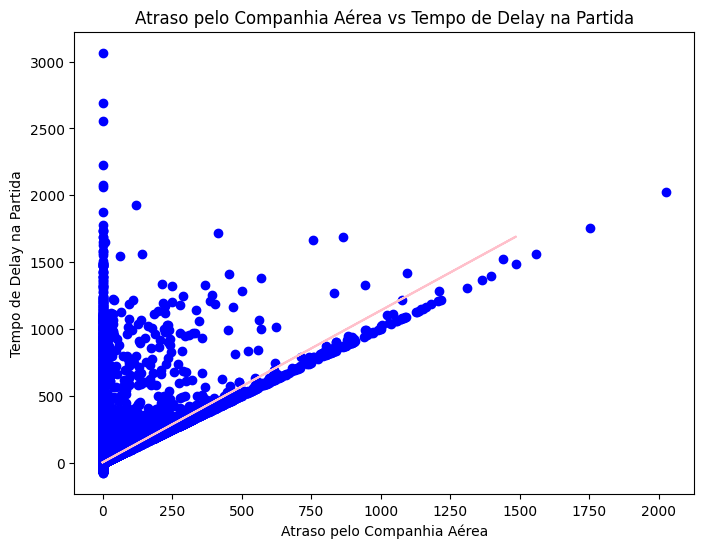

Coeficiente r2: 0.3584435988004586


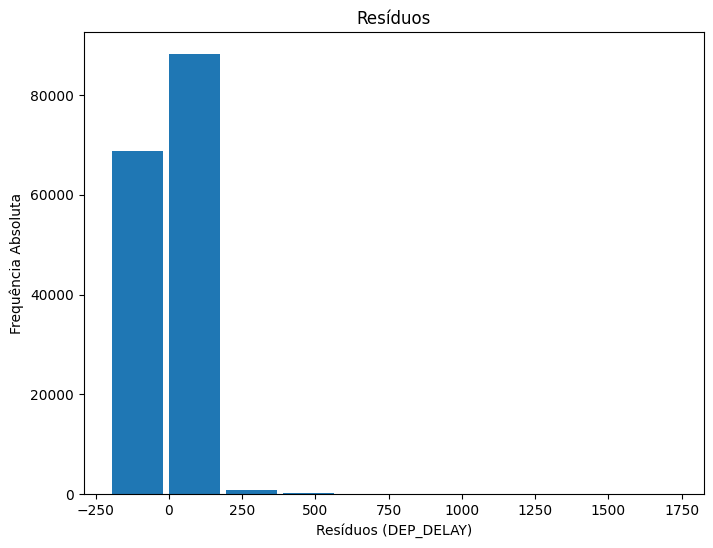

In [42]:

# Plotando o Gráfico de Dispersão e Calculando o índice de correlação
X = df['DELAY_DUE_LATE_AIRCRAFT'].values
Y = df['ARR_DELAY'].values

# Calculando o índice de correlação
r = pearsonr(X, Y)
print(f'Coeficiente de correlação: {r}')

# Separarando os dados de treino e teste
x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

# Redimensionando os dados para fazer a regressão linear
x_train = x_train.reshape(-1, 1)
x_test = x_test.reshape(-1, 1)

# Treinando o modelo
reg = LinearRegression()
reg.fit(x_train, y_train)
pred = reg.predict(x_test)

# Ajuste o tamanho da figura
plt.figure(figsize=(8, 6))  # Defina a largura e altura desejadas
# Plotando o Gráfico de Dispersão
plt.scatter(X, Y, color="blue")
plt.plot(x_test, pred, color="pink")
plt.title("Atraso pelo Companhia Aérea vs Tempo de Delay na Partida")
plt.xlabel("Atraso pelo Companhia Aérea")
plt.ylabel("Tempo de Delay na Partida")
plt.show()

# Verificando a representação do modelo
r_squared = r2_score(y_test, pred)
print(f'Coeficiente r2: {r_squared}')

# Calculando os resíduos
residual = y_test - pred

# Ajustando o tamanho da figura
plt.figure(figsize=(8, 6))
# Plotando o histograma dos resíduos
plt.hist(residual, rwidth=0.9)
plt.title('Resíduos')
plt.xlabel('Resíduos (DEP_DELAY)')
plt.ylabel('Frequência Absoluta')
plt.show()

Coeficiente de correlação: PearsonRResult(statistic=0.0053739968056685326, pvalue=9.540572719249753e-05)


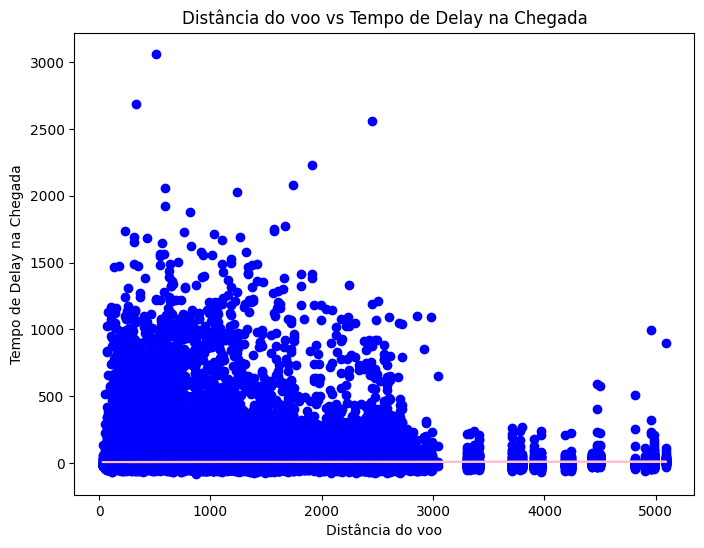

Coeficiente r2: 4.1660396894682705e-05


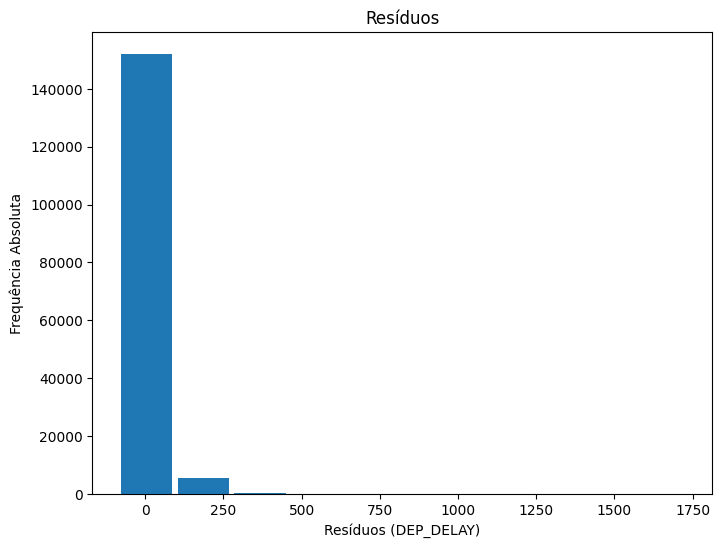

In [43]:

# Plotando o Gráfico de Dispersão e Calculando o índice de correlação
X = df['DISTANCE'].values
Y = df['ARR_DELAY'].values

# Calculando o índice de correlação
r = pearsonr(X, Y)
print(f'Coeficiente de correlação: {r}')

# Separarando os dados de treino e teste
x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

# Redimensionando os dados para fazer a regressão linear
x_train = x_train.reshape(-1, 1)
x_test = x_test.reshape(-1, 1)

# Treinando o modelo
reg = LinearRegression()
reg.fit(x_train, y_train)
pred = reg.predict(x_test)

# Ajuste o tamanho da figura
plt.figure(figsize=(8, 6))  # Defina a largura e altura desejadas
# Plotando o Gráfico de Dispersão
plt.scatter(X, Y, color="blue")
plt.plot(x_test, pred, color="pink")
plt.title("Distância do voo vs Tempo de Delay na Chegada")
plt.xlabel("Distância do voo")
plt.ylabel("Tempo de Delay na Chegada")
plt.show()

# Verificando a representação do modelo
r_squared = r2_score(y_test, pred)
print(f'Coeficiente r2: {r_squared}')

# Calculando os resíduos
residual = y_test - pred

# Ajustando o tamanho da figura
plt.figure(figsize=(8, 6))
# Plotando o histograma dos resíduos
plt.hist(residual, rwidth=0.9)
plt.title('Resíduos')
plt.xlabel('Resíduos (DEP_DELAY)')
plt.ylabel('Frequência Absoluta')
plt.show()


## Regressão logística

In [ ]:
df = df[colunas_selecionadas].copy()
# Criar a variável binária para DEP_DELAY
df['HAS_DELAY'] = np.where(df['DEP_DELAY'] >= 10, 1, 0)
# Criar variáveis binárias para DAY_OF_WEEK
df['DAY_OF_WEEK_BINARY'] = np.where(df['DAY_OF_WEEK'].isin(['Monday', 'Wednesday']), 1, 0)
# Criar variáveis binárias para CAT_CRS_DEP_TIME
df['CAT_CRS_DEP_TIME_BINARY'] = np.where(df['CAT_CRS_DEP_TIME'].isin(['Afternoon', 'Evening']), 1, 0)
# Criar variáveis binárias para tipos de atraso
df['DELAY_DUE_CARRIER_BINARY'] = np.where(df['DELAY_DUE_CARRIER'] > 10, 1, 0)
df['DELAY_DUE_NAS_BINARY'] = np.where(df['DELAY_DUE_NAS'] > 10, 1, 0)
df['DELAY_DUE_WEATHER_BINARY'] = np.where(df['DELAY_DUE_WEATHER'] > 10, 1, 0)
df['DELAY_DUE_SECURITY_BINARY'] = np.where(df['DELAY_DUE_SECURITY'] > 10, 1, 0)
df['DELAY_DUE_LATE_AIRCRAFT_BINARY'] = np.where(df['DELAY_DUE_LATE_AIRCRAFT'] > 10, 1, 0)
# Calcular a taxa de atraso por rotas
tabela_flight_route['delay_rate'] = (tabela_flight_route['TOTAL_DELAY_FLAG'] / tabela_flight_route['TOTAL_FLIGHTS']) * 100
# Criar uma coluna binária para FLIGHT_ROUTE com base na taxa de atraso
tabela_flight_route['FLIGHT_ROUTE_BINARY'] = np.where(tabela_flight_route['delay_rate'] >= 50, 1, 0)
# Mapear os valores binários de FLIGHT_ROUTE para o DataFrame original
flight_route_map = tabela_flight_route.set_index('FLIGHT_ROUTE')['FLIGHT_ROUTE_BINARY'].to_dict()
df['FLIGHT_ROUTE_BINARY'] = df['FLIGHT_ROUTE'].map(flight_route_map)
# Verificar se há valores nulos e substituí-los por 0 (caso alguma rota não esteja no map)
df['FLIGHT_ROUTE_BINARY'].fillna(0, inplace=True)
# Selecionar as colunas desejadas para a regressão logística
columns_for_logistic_regression = [
    'HAS_DELAY',
    'DAY_OF_WEEK_BINARY',
    'CAT_CRS_DEP_TIME_BINARY',
    'DELAY_DUE_CARRIER_BINARY',
    'DELAY_DUE_NAS_BINARY',
    'DELAY_DUE_WEATHER_BINARY',
    'DELAY_DUE_SECURITY_BINARY',
    'DELAY_DUE_LATE_AIRCRAFT_BINARY',
    'FLIGHT_ROUTE_BINARY'
]
df_logistic_regression = df[columns_for_logistic_regression]
# Verificar a nova tabela
print(df_logistic_regression.head())

   HAS_DELAY  DAY_OF_WEEK_BINARY  CAT_CRS_DEP_TIME_BINARY  \
0          0                   1                        0   
1          0                   0                        0   
2          0                   1                        0   
3          0                   0                        0   
4          0                   0                        0   

   DELAY_DUE_CARRIER_BINARY  DELAY_DUE_NAS_BINARY  DELAY_DUE_WEATHER_BINARY  \
0                         0                     0                         0   
1                         0                     0                         0   
2                         0                     0                         0   
3                         0                     0                         0   
4                         0                     0                         0   

   DELAY_DUE_SECURITY_BINARY  DELAY_DUE_LATE_AIRCRAFT_BINARY  \
0                          0                               0   
1                          0  

In [ ]:
df_logistic_regression

,HAS_DELAY,DAY_OF_WEEK_BINARY,CAT_CRS_DEP_TIME_BINARY,DELAY_DUE_CARRIER_BINARY,DELAY_DUE_NAS_BINARY,DELAY_DUE_WEATHER_BINARY,DELAY_DUE_SECURITY_BINARY,DELAY_DUE_LATE_AIRCRAFT_BINARY,FLIGHT_ROUTE_BINARY
0,0,1,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0
2,0,1,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...
527192,0,1,0,0,0,0,0,0,0
527193,1,1,0,0,0,0,0,0,0
527194,0,1,0,0,0,0,0,0,0
527195,1,1,1,0,1,0,0,0,0


<Axes: xlabel='HAS_DELAY', ylabel='count'>

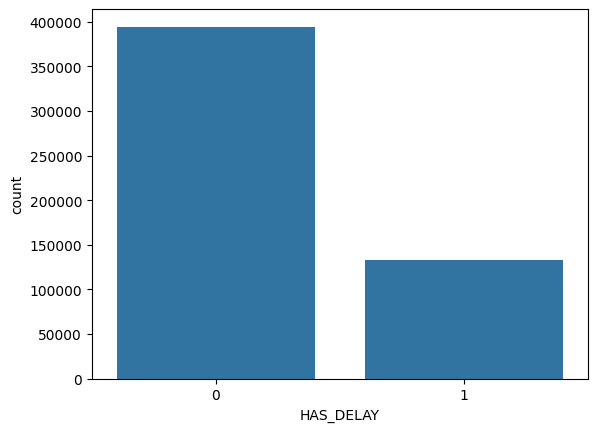

In [ ]:
sns.countplot(x = df_logistic_regression['HAS_DELAY'])

In [ ]:
df_logistic_regression['HAS_DELAY'].value_counts()

HAS_DELAY
0    394322
1    132875
Name: count, dtype: int64

In [ ]:
sem_atraso_percentage = df_logistic_regression[df_logistic_regression['HAS_DELAY'] == 0].shape[0] / df_logistic_regression.shape[0] * 100
com_atraso_percentage = df_logistic_regression[df_logistic_regression['HAS_DELAY'] == 1].shape[0] / df_logistic_regression.shape[0] * 100

print(f'The percentage of:\n'
      f'Sem_atraso: {sem_atraso_percentage:.2f}%\n'
      f'Com_atraso: {com_atraso_percentage:.2f}%\n'
      )


The percentage of:
Sem_atraso: 74.80%
Com_atraso: 25.20%



In [ ]:
#dividindo os dados em conjuntos de treinamento e teste
x = df_logistic_regression.drop(['HAS_DELAY'], axis = 1) #features = variaveis independentes
y = df_logistic_regression['HAS_DELAY'] #target

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=42)
#treino: 70% e teste:30%

In [ ]:
cols = df_logistic_regression.columns.drop(['HAS_DELAY'])
formula = 'HAS_DELAY ~ ' + ' + '.join(cols)
print(formula, '\n')

HAS_DELAY ~ DAY_OF_WEEK_BINARY + CAT_CRS_DEP_TIME_BINARY + DELAY_DUE_CARRIER_BINARY + DELAY_DUE_NAS_BINARY + DELAY_DUE_WEATHER_BINARY + DELAY_DUE_SECURITY_BINARY + DELAY_DUE_LATE_AIRCRAFT_BINARY + FLIGHT_ROUTE_BINARY 



In [ ]:
model = smf.glm(formula=formula, data=x_train.join(y_train), family=sm.families.Binomial())
logistic_fit = model.fit()
print(logistic_fit.summary())

                 Generalized Linear Model Regression Results                  
Dep. Variable:              HAS_DELAY   No. Observations:               369037
Model:                            GLM   Df Residuals:                   369028
Model Family:                Binomial   Df Model:                            8
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:            -1.0907e+05
Date:                Mon, 15 Jul 2024   Deviance:                   2.1814e+05
Time:                        13:55:26   Pearson chi2:                 3.56e+05
No. Iterations:                     9   Pseudo R-squ. (CS):             0.4165
Covariance Type:            nonrobust                                         
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
Intercept   

In [ ]:
# Fazer previsões nos dados de teste
y_pred_prob = logistic_fit.predict(x_test)
# Converter probabilidades em classes
y_pred = [1 if x > 0.5 else 0 for x in y_pred_prob]


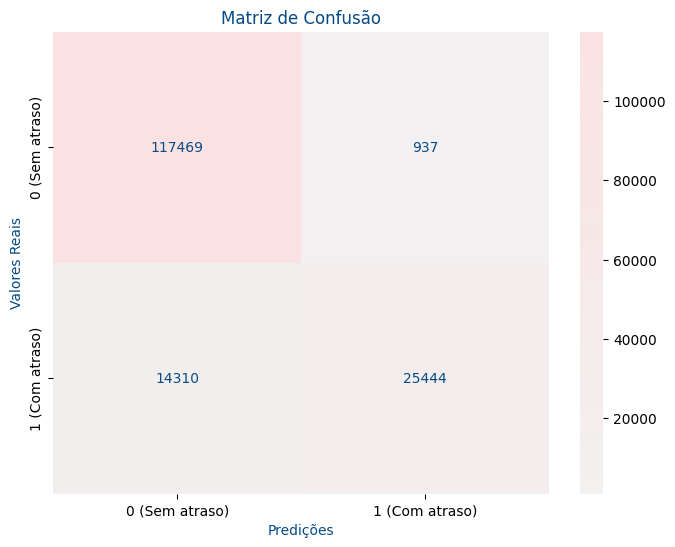

True Positive: 25444
False Positive: 937
False Negative: 14310
True Negative: 117469
Accuracy: 0.9035976226605968
Acurácia Balanceada: 0.816
Precision: 0.9644820135703727
Recall: 0.6400362227700357
F1 Score: 0.7694564149088985


In [ ]:
from sklearn import metrics
from sklearn.metrics import accuracy_score, balanced_accuracy_score, precision_score, recall_score, f1_score
import matplotlib.pyplot as plt
import seaborn as sns

# Calcular a matriz de confusão
cm = metrics.confusion_matrix(y_test, y_pred)
tn, fp, fn, tp = cm.ravel()

# Calcular as métricas de desempenho
accuracy = accuracy_score(y_test, y_pred)
acuracia_balanceada = balanced_accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

# Definindo as cores
cor_barra = "#fbe2e2"
cor_texto = "#064b85"

# Visualização gráfica da matriz
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap=sns.light_palette(cor_barra, as_cmap=True),
            annot_kws={"color": cor_texto}, xticklabels=['0 (Sem atraso)', '1 (Com atraso)'],
            yticklabels=['0 (Sem atraso)', '1 (Com atraso)'])
plt.xlabel('Predições', color=cor_texto)
plt.ylabel('Valores Reais', color=cor_texto)
plt.title('Matriz de Confusão', color=cor_texto)
plt.show()

print(f'True Positive: {tp}')
print(f'False Positive: {fp}')
print(f'False Negative: {fn}')
print(f'True Negative: {tn}')
print(f'Accuracy: {accuracy}')
print(f"Acurácia Balanceada: {acuracia_balanceada:.3f}")
print(f'Precision: {precision}')
print(f'Recall: {recall}')
print(f'F1 Score: {f1}')



## Verificando Multicolinearidade

In [ ]:
# Importar bibliotecas necessárias
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Definir as variáveis independentes
X = df_logistic_regression.drop(['HAS_DELAY'], axis=1)

# Calcular o VIF para cada variável independente
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns
vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

print(vif_data)


                          feature       VIF
0              DAY_OF_WEEK_BINARY  1.238697
1         CAT_CRS_DEP_TIME_BINARY  1.341179
2        DELAY_DUE_CARRIER_BINARY  1.110134
3            DELAY_DUE_NAS_BINARY  1.100508
4        DELAY_DUE_WEATHER_BINARY  1.017500
5       DELAY_DUE_SECURITY_BINARY  1.001041
6  DELAY_DUE_LATE_AIRCRAFT_BINARY  1.156786
7             FLIGHT_ROUTE_BINARY  1.012302


## Regressão somente com 3 variaveis independentes

Matriz de Confusão:
[[117954    452]
 [ 39094    660]]
True Positive: 660
False Positive: 452
False Negative: 39094
True Negative: 117954
Acurácia: 0.7499620637329287
Precisão: 0.5935251798561151
Recall: 0.016602102933038185
F1-score: 0.03230069006019674
AUC ROC: 0.6059685615850862
Log Loss: 0.5487361834133744


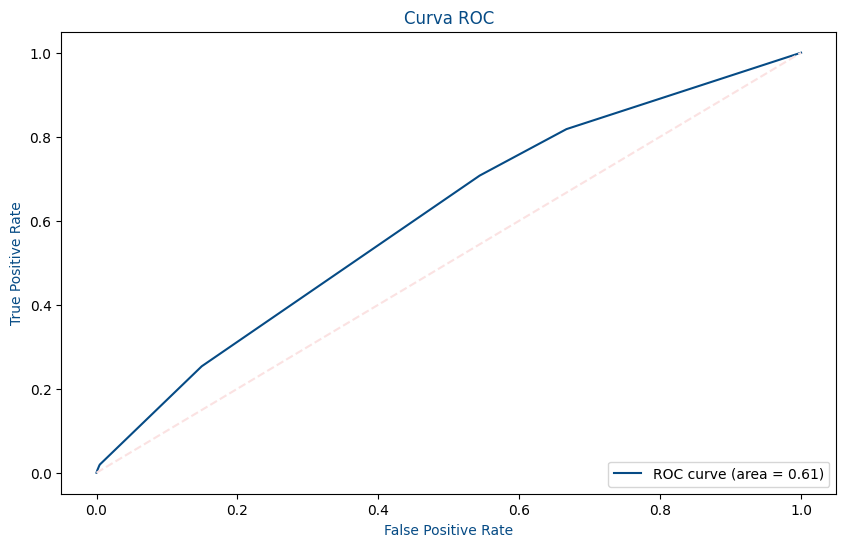

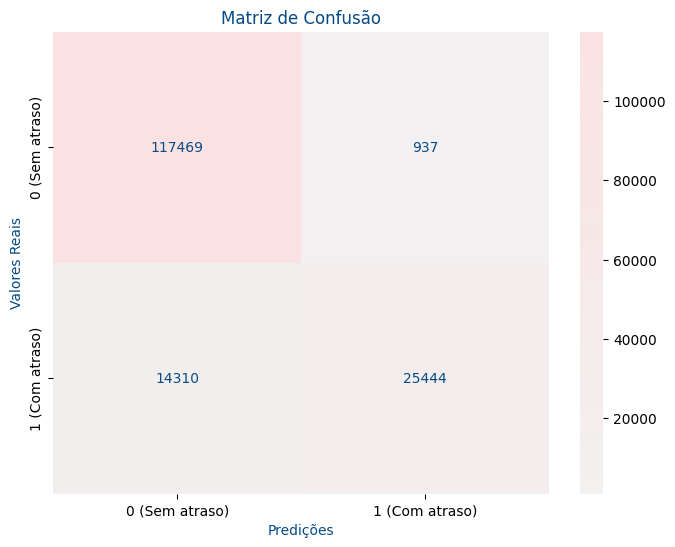

In [ ]:
# Dividindo os dados em conjuntos de treinamento e teste
x = df_logistic_regression[['DAY_OF_WEEK_BINARY', 'CAT_CRS_DEP_TIME_BINARY', 'FLIGHT_ROUTE_BINARY']] # features = variaveis independentes
y = df_logistic_regression['HAS_DELAY'] # target
# treino: 70% e teste: 30%
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=42)

# Criar o modelo de regressão logística
model = LogisticRegression()

# Treinar o modelo
model.fit(x_train, y_train)

# Prever os valores para o conjunto de teste
y_prob = model.predict_proba(x_test)[:, 1]
y_pred = model.predict(x_test)

# Calcular a curva ROC e a área sob a curva (AUC)
fpr, tpr, _ = roc_curve(y_test, y_prob)
roc_auc = roc_auc_score(y_test, y_prob)

# Calcular a matriz de confusão
conf_matrix = confusion_matrix(y_test, y_pred)
true_positive = conf_matrix[1, 1]
false_positive = conf_matrix[0, 1]
false_negative = conf_matrix[1, 0]
true_negative = conf_matrix[0, 0]

# Calcular as métricas de desempenho
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)
roc_auc = roc_auc_score(y_test, y_prob)
log_loss_value = log_loss(y_test, y_prob)

# Exibir as métricas de desempenho
print("Matriz de Confusão:")
print(conf_matrix)
print("True Positive:", true_positive)
print("False Positive:", false_positive)
print("False Negative:", false_negative)
print("True Negative:", true_negative)
print("Acurácia:", accuracy)
print("Precisão:", precision)
print("Recall:", recall)
print("F1-score:", f1)
print("AUC ROC:", roc_auc)
print("Log Loss:", log_loss_value)

# Definir as cores desejadas
cor_barra = "#fbe2e2"
cor_texto = "#064b85"

# Plotar a curva ROC
plt.figure(figsize=(10, 6))
plt.plot(fpr, tpr, color=cor_texto, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color=cor_barra, linestyle='--')
plt.xlabel('False Positive Rate', color=cor_texto)
plt.ylabel('True Positive Rate', color=cor_texto)
plt.title('Curva ROC', color=cor_texto)
plt.legend(loc="lower right")
plt.show()

# Criar uma nova paleta de cores
cmap = sns.color_palette([cor_barra, cor_texto])

# Visualização gráfica da matriz de confusão
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap=sns.light_palette(cor_barra, as_cmap=True),
            annot_kws={"color": cor_texto}, xticklabels=['0 (Sem atraso)', '1 (Com atraso)'],
            yticklabels=['0 (Sem atraso)', '1 (Com atraso)'])
plt.xlabel('Predições', color=cor_texto)
plt.ylabel('Valores Reais', color=cor_texto)
plt.title('Matriz de Confusão', color=cor_texto)
plt.show()





## Regressão logistica utilizando a técnica SMOTE devido ao desbalanceamento dos dados

HAS_DELAY ~ DAY_OF_WEEK_BINARY + CAT_CRS_DEP_TIME_BINARY + DELAY_DUE_CARRIER_BINARY + DELAY_DUE_NAS_BINARY + DELAY_DUE_WEATHER_BINARY + DELAY_DUE_SECURITY_BINARY + DELAY_DUE_LATE_AIRCRAFT_BINARY + FLIGHT_ROUTE_BINARY 

                 Generalized Linear Model Regression Results                  
Dep. Variable:              HAS_DELAY   No. Observations:               551832
Model:                            GLM   Df Residuals:                   551823
Model Family:                Binomial   Df Model:                            8
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:            -2.1582e+05
Date:                Mon, 15 Jul 2024   Deviance:                   4.3164e+05
Time:                        13:56:32   Pearson chi2:                 5.15e+05
No. Iterations:                    10   Pseudo R-squ. (CS):             0.4534
Covariance Type:            nonrobust                                 

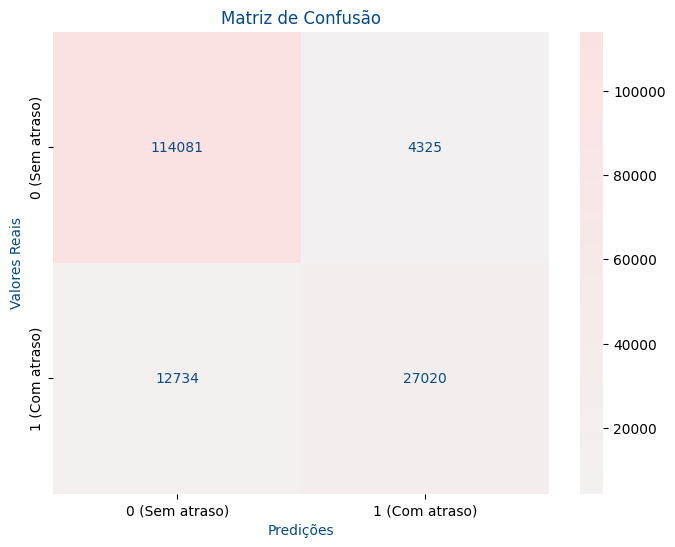

True Positive: 27020
False Positive: 4325
False Negative: 12734
True Negative: 114081
Accuracy: 0.8921408700050582
Acurácia Balanceada: 0.822
Precision: 0.8620194608390493
Recall: 0.6796800321980178
F1 Score: 0.7600669489022349


In [ ]:
# Divisão dos dados em conjuntos de treinamento e teste
x = df_logistic_regression.drop(['HAS_DELAY'], axis=1)  # Features
y = df_logistic_regression['HAS_DELAY']  # Target

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=42)

# Aplicar SMOTE ao conjunto de treino
smote = SMOTE(random_state=42)
x_train_res, y_train_res = smote.fit_resample(x_train, y_train)

# Criação e ajuste do modelo de regressão logística
cols = df_logistic_regression.columns.drop(['HAS_DELAY'])
formula = 'HAS_DELAY ~ ' + ' + '.join(cols)
print(formula, '\n')

model = smf.glm(formula=formula, data=x_train_res.join(y_train_res), family=sm.families.Binomial())
logistic_fit = model.fit()
print(logistic_fit.summary())

# Fazer previsões nos dados de teste
y_pred_prob = logistic_fit.predict(x_test)
# Converter probabilidades em classes
y_pred = [1 if x > 0.5 else 0 for x in y_pred_prob]

# Calcular a matriz de confusão e métricas de desempenho
cm = metrics.confusion_matrix(y_test, y_pred)
tn, fp, fn, tp = cm.ravel()

accuracy = accuracy_score(y_test, y_pred)
acuracia_balanceada = balanced_accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

# Definindo as cores
cor_barra = "#fbe2e2"
cor_texto = "#064b85"

# Visualização gráfica da matriz de confusão
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap=sns.light_palette(cor_barra, as_cmap=True),
            annot_kws={"color": cor_texto}, xticklabels=['0 (Sem atraso)', '1 (Com atraso)'],
            yticklabels=['0 (Sem atraso)', '1 (Com atraso)'])
plt.xlabel('Predições', color=cor_texto)
plt.ylabel('Valores Reais', color=cor_texto)
plt.title('Matriz de Confusão', color=cor_texto)
plt.show()

print(f'True Positive: {tp}')
print(f'False Positive: {fp}')
print(f'False Negative: {fn}')
print(f'True Negative: {tn}')
print(f'Accuracy: {accuracy}')
print(f"Acurácia Balanceada: {acuracia_balanceada:.3f}")
print(f'Precision: {precision}')
print(f'Recall: {recall}')
print(f'F1 Score: {f1}')


## SMOTE apenas com 3 variáveis independentes

Matriz de Confusão:
[[54009 64397]
 [11629 28125]]
True Positive: 28125
False Positive: 64397
False Negative: 11629
True Negative: 54009
Acurácia: 0.519309559939302
Precisão: 0.3039817556905385
Recall: 0.7074759772601499
F1-score: 0.4252472103782999
AUC ROC: 0.6059685615850862
Log Loss: 17.325839609009993


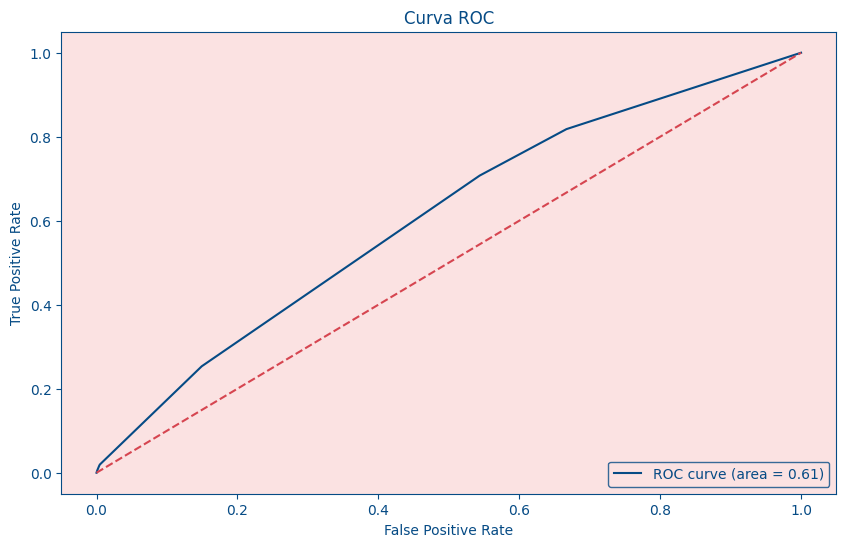

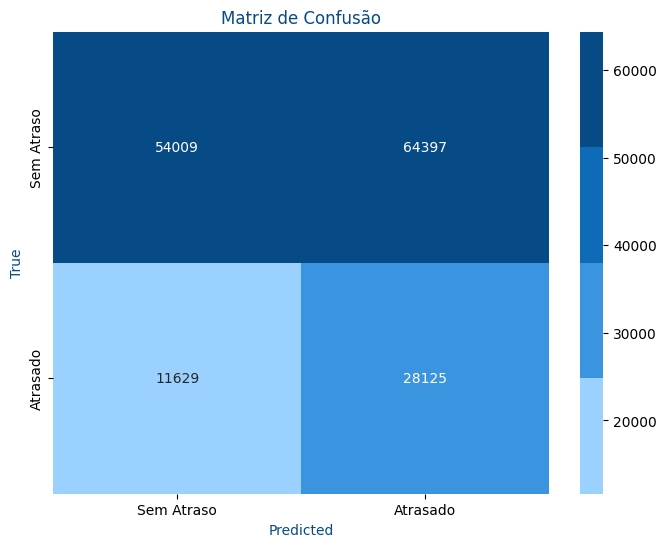

In [ ]:
# Dividindo os dados em conjuntos de treinamento e teste
x = df_logistic_regression[['DAY_OF_WEEK_BINARY', 'CAT_CRS_DEP_TIME_BINARY', 'FLIGHT_ROUTE_BINARY']]  # features = variáveis independentes
y = df_logistic_regression['HAS_DELAY']  # target
# Treino: 70% e teste: 30%
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=42)
# Aplicar SMOTE apenas nos dados de treinamento
smote = SMOTE(random_state=42)
x_train_resampled, y_train_resampled = smote.fit_resample(x_train, y_train)
# Criar o modelo de regressão logística
model = LogisticRegression()
# Treinar o modelo com dados balanceados
model.fit(x_train_resampled, y_train_resampled)
# Prever os valores para o conjunto de teste
y_prob = model.predict_proba(x_test)[:, 1]
y_pred = model.predict(x_test)
# Calcular a curva ROC e a área sob a curva (AUC)
fpr, tpr, _ = roc_curve(y_test, y_prob)
roc_auc = roc_auc_score(y_test, y_prob)
# Calcular a matriz de confusão
conf_matrix = confusion_matrix(y_test, y_pred)
true_positive = conf_matrix[1, 1]
false_positive = conf_matrix[0, 1]
false_negative = conf_matrix[1, 0]
true_negative = conf_matrix[0, 0]
# Calcular as métricas de desempenho
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)
log_loss = log_loss(y_test, y_pred)
# Exibir as métricas de desempenho
print("Matriz de Confusão:")
print(conf_matrix)
print("True Positive:", true_positive)
print("False Positive:", false_positive)
print("False Negative:", false_negative)
print("True Negative:", true_negative)
print("Acurácia:", accuracy)
print("Precisão:", precision)
print("Recall:", recall)
print("F1-score:", f1)
print("AUC ROC:", roc_auc)
print("Log Loss:", log_loss)
# Plotar a curva ROC com cores personalizadas
plt.figure(figsize=(10, 6))
plt.plot(fpr, tpr, color='#064B85', label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='#D64550', linestyle='--')
plt.xlabel('False Positive Rate', color='#064B85')
plt.ylabel('True Positive Rate', color='#064B85')
plt.title('Curva ROC', color='#064B85')
plt.legend(loc="lower right", facecolor='#FBE2E2', edgecolor='#064B85', labelcolor='#064B85')
plt.gca().set_facecolor('#FBE2E2')
plt.gca().spines['bottom'].set_color('#064B85')
plt.gca().spines['top'].set_color('#064B85')
plt.gca().spines['right'].set_color('#064B85')
plt.gca().spines['left'].set_color('#064B85')
plt.gca().tick_params(colors='#064B85')
plt.show()
# Plotar o mapa de calor da matriz de confusão com cores personalizadas
plt.figure(figsize=(8, 6))
cmap = sns.color_palette(["#9AD1FF", "#3B94DF", "#0E6BB8", "#064B85"], as_cmap=True)
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap=cmap, xticklabels=['Sem Atraso', 'Atrasado'], yticklabels=['Sem Atraso', 'Atrasado'])
plt.xlabel('Predicted', color='#064B85')
plt.ylabel('True', color='#064B85')
plt.title('Matriz de Confusão', color='#064B85')
plt.gca().set_facecolor('#FBE2E2')
plt.show()


## Utilizando ADASYN

Matriz de Confusão:
[[86138 32268]
 [25281 14473]]
True Positive: 14473
False Positive: 32268
False Negative: 25281
True Negative: 86138
Acurácia: 0.6361342943854325
Precisão: 0.3096424980210094
Recall: 0.3640639935603964
F1-score: 0.3346551823804844
AUC ROC: 0.5936909305285968
Log Loss: 0.6701103517208126


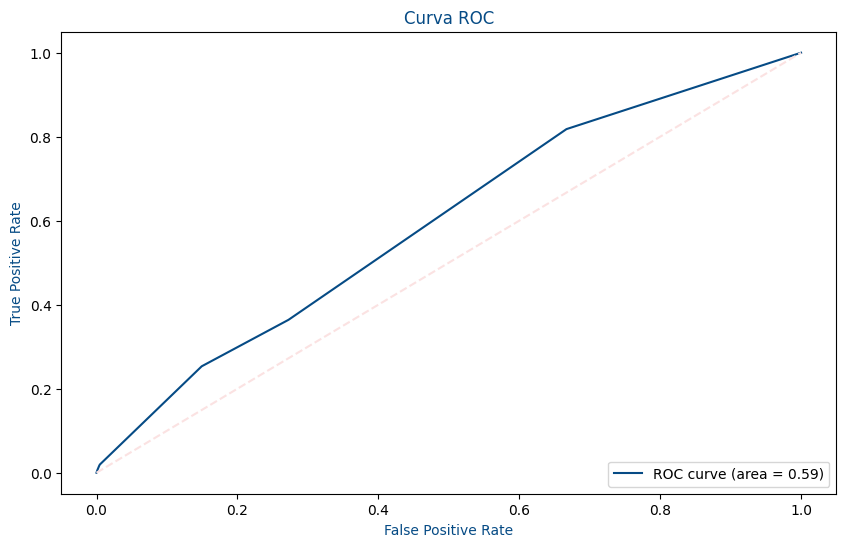

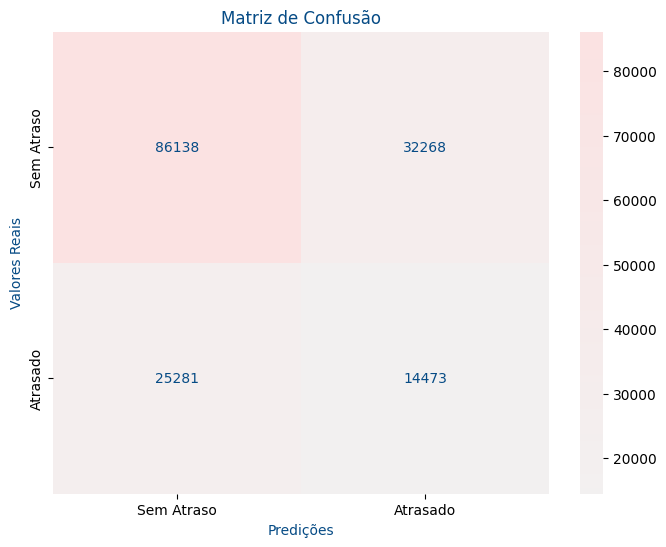

In [ ]:
# Dividindo os dados em conjuntos de treinamento e teste
x = df_logistic_regression[['DAY_OF_WEEK_BINARY', 'CAT_CRS_DEP_TIME_BINARY', 'FLIGHT_ROUTE_BINARY']]  # features = variáveis independentes
y = df_logistic_regression['HAS_DELAY']  # target

# Treino: 70% e teste: 30%
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=42)

# Aplicar ADASYN apenas nos dados de treinamento
adasyn = ADASYN(random_state=42)
x_train_resampled, y_train_resampled = adasyn.fit_resample(x_train, y_train)

# Criar o modelo de regressão logística
model = LogisticRegression()

# Treinar o modelo com dados balanceados
model.fit(x_train_resampled, y_train_resampled)

# Prever os valores para o conjunto de teste
y_prob = model.predict_proba(x_test)[:, 1]
y_pred = model.predict(x_test)

# Calcular a curva ROC e a área sob a curva (AUC)
fpr, tpr, _ = roc_curve(y_test, y_prob)
roc_auc = roc_auc_score(y_test, y_prob)

# Calcular a matriz de confusão
conf_matrix = confusion_matrix(y_test, y_pred)
true_positive = conf_matrix[1, 1]
false_positive = conf_matrix[0, 1]
false_negative = conf_matrix[1, 0]
true_negative = conf_matrix[0, 0]

# Calcular as métricas de desempenho
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)
log_loss_value = log_loss(y_test, y_prob)

# Exibir as métricas de desempenho
print("Matriz de Confusão:")
print(conf_matrix)
print("True Positive:", true_positive)
print("False Positive:", false_positive)
print("False Negative:", false_negative)
print("True Negative:", true_negative)
print("Acurácia:", accuracy)
print("Precisão:", precision)
print("Recall:", recall)
print("F1-score:", f1)
print("AUC ROC:", roc_auc)
print("Log Loss:", log_loss_value)

# Definir as cores desejadas
cor_barra = "#fbe2e2"
cor_texto = "#064b85"

# Plotar a curva ROC
plt.figure(figsize=(10, 6))
plt.plot(fpr, tpr, color=cor_texto, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color=cor_barra, linestyle='--')
plt.xlabel('False Positive Rate', color=cor_texto)
plt.ylabel('True Positive Rate', color=cor_texto)
plt.title('Curva ROC', color=cor_texto)
plt.legend(loc="lower right")
plt.show()

# Visualização gráfica da matriz de confusão
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap=sns.light_palette(cor_barra, as_cmap=True),
            annot_kws={"color": cor_texto}, xticklabels=['Sem Atraso', 'Atrasado'],
            yticklabels=['Sem Atraso', 'Atrasado'])
plt.xlabel('Predições', color=cor_texto)
plt.ylabel('Valores Reais', color=cor_texto)
plt.title('Matriz de Confusão', color=cor_texto)
plt.show()


## Observação com vários limiares

   Threshold  Accuracy  Precision    Recall        F1  True Positive  False Positive  False Negative  True Negative
0        0.1  0.251353   0.251353  1.000000  0.401730          39754          118406               0              0
1        0.2  0.251353   0.251353  1.000000  0.401730          39754          118406               0              0
2        0.3  0.251353   0.251353  1.000000  0.401730          39754          118406               0              0
3        0.4  0.454900   0.291677  0.818132  0.430038          32524           78983            7230          39423
4        0.5  0.519310   0.303982  0.707476  0.425247          28125           64397           11629          54009
5        0.6  0.700544   0.362949  0.253408  0.298445          10074           17682           29680         100724
6        0.7  0.750000   0.580090  0.019495  0.037722            775             561           38979         117845
7        0.8  0.749880   0.594385  0.015445  0.030108            614    

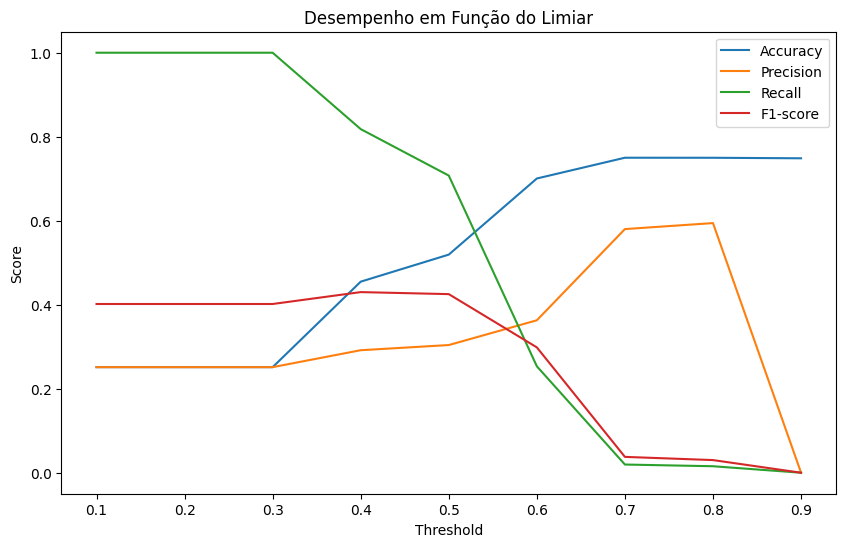

In [ ]:
# Dividindo os dados em conjuntos de treinamento e teste
x = df_logistic_regression[['DAY_OF_WEEK_BINARY', 'CAT_CRS_DEP_TIME_BINARY', 'FLIGHT_ROUTE_BINARY']]  # features = variáveis independentes
y = df_logistic_regression['HAS_DELAY']  # target
# Treino: 70% e teste: 30%
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=42)
# Aplicar SMOTE apenas nos dados de treinamento
smote = SMOTE(random_state=42)
x_train_resampled, y_train_resampled = smote.fit_resample(x_train, y_train)
# Criar o modelo de regressão logística
model = LogisticRegression()
# Treinar o modelo com dados balanceados
model.fit(x_train_resampled, y_train_resampled)
# Prever as probabilidades para o conjunto de teste
y_prob = model.predict_proba(x_test)[:, 1]
# Definir os limiares a serem testados
thresholds = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
# Armazenar as métricas para cada limiar
results = []
for threshold in thresholds:
    # Calcular previsões binárias com base no limiar
    y_pred_threshold = (y_prob >= threshold).astype(int)
    # Calcular a matriz de confusão
    conf_matrix = confusion_matrix(y_test, y_pred_threshold)
    true_positive = conf_matrix[1, 1]
    false_positive = conf_matrix[0, 1]
    false_negative = conf_matrix[1, 0]
    true_negative = conf_matrix[0, 0]
    # Calcular as métricas de desempenho
    accuracy = accuracy_score(y_test, y_pred_threshold)
    precision = precision_score(y_test, y_pred_threshold, zero_division=0)
    recall = recall_score(y_test, y_pred_threshold)
    f1 = f1_score(y_test, y_pred_threshold)
    # Armazenar os resultados
    results.append({
        'Threshold': threshold,
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1': f1,
        'True Positive': true_positive,
        'False Positive': false_positive,
        'False Negative': false_negative,
        'True Negative': true_negative
    })
# Converter os resultados para um DataFrame
results_df = pd.DataFrame(results)
# Exibir os resultados
print(results_df)
# Plotar as métricas de desempenho em função dos limiares
plt.figure(figsize=(10, 6))
plt.plot(results_df['Threshold'], results_df['Accuracy'], label='Accuracy')
plt.plot(results_df['Threshold'], results_df['Precision'], label='Precision')
plt.plot(results_df['Threshold'], results_df['Recall'], label='Recall')
plt.plot(results_df['Threshold'], results_df['F1'], label='F1-score')
plt.xlabel('Threshold')
plt.ylabel('Score')
plt.title('Desempenho em Função do Limiar')
plt.legend()
plt.show()



## Baixando o DF

In [ ]:
#Salvando o DataFrame como um arquivo CSV
# Baixar o arquivo CSV
from google.colab import files
files.download('analise_resultados.csv')